In [1]:
import pandas as pd
import numpy as np
import pandas as pd
import numpy as np
import requests as requests
import json
import urllib
from pandas import to_datetime
import seaborn as sns
import matplotlib.pyplot as plt
from unidecode import unidecode
import pandas as pd
import requests as requests
import json
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler
import time
import statistics
import glob
import pandas_profiling
import geopandas as gpd
from shapely.affinity import translate
from io import BytesIO
import zipfile

/tmp/ipykernel_12817/2877510318.py:24: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  import pandas_profiling


# EFAT MODEL & CONCLUSIONS

In this notebook we are compiling all the analysis we have made along the different notebooks related to each technology -in which we have considered only 2014 for the analysis as a naive approach to a better understanding of the files- and we are including also the information related to the 'Provincias' in order to create the final model we were looking for. 
The notebook will analyze the different tchnologies separately as they are not directly related and the variables including in the study affect in a different manner to the different targets.
In this analysis we will use information related to:

    - Energetic Generation: extracted from Red Eléctrica de España (REE) website in several files (on a yearly basis)
    - Weather historical data: from AEMET API, it contains information related to the meteo stations of the whole country.
    - Provincias: As we want to take into consideration geo data but it is complicated to have all the detail, we are considering 'Provincias' as geo reference for the data we are analyzing.
    - Power Installed: It's a critical variable and it is provided also by REE in a monthly basis.
    - Weather_Predictions: It will be the 'food' for the model to work. The test data that we want to predict.
    - 'Embalses / Dams' Info: Critical for hidroelectric production.


All the data will be analyzed from 2015 to 2022 in order to include the info related to PowerInstalled(only available from 2015 onwards). It would be interesting to analyze if 2020 can be removed as it is highly affected by COVID-19 crisis.
The data we are working with in the notebook have been uploaded to a Google Drive Public folder:

https://drive.google.com/drive/folders/1Y36_4Z-JY7Ig6lpNZeMfToooRL12pdvo

The main files that we are going to use in this notebook are the following ones:
- Energetic Generation by technogogy in a daily basis data 2014-2022, Red Eléctrica Española (REE) : https://drive.google.com/file/d/1CKWK6ikb_qLquuIpnUSTYtqmwRxX4N9J/view?usp=drive_lin
- Energetic Generation data by CCAA in a monthly basis 2014-2022, REE: 'https://drive.google.com/file/d/1Zhaf_jFYweVZ9iixT-Q5eB6_4RzXOewZ/view?usp=drive_link'
- Energetic Demand in a daily basis, REE: https://drive.google.com/file/d/1f0VtPLUQtxXNr7M1YDWZtsiyecBy238P/view?usp=drive_link
- Energetic Demand in a monthly basis by CCAA, REE: https://drive.google.com/file/d/1YGsqSUgKPtmJMe1Xch9A_C3rAMy0udSK/view?usp=drive_link
- Weather metada (in order to understand weather information), Agencia Española de Meteorología (AEMET): 'https://drive.google.com/file/d/1l3bYxhw4XeGlEfsu1F4ptCqDWYl2a64x/view?usp=drive_link'
- Weather data from AEMET 2014-2022: 'https://drive.google.com/file/d/1FJ2dPeL-qrTYLALtEI_m4q3cP2M0oBYK/view?usp=drive_link'
- Information regarding the Spanish water reservoir status, MInisterio para la Transición Ecológica y el Reto Demográfico (MITECO): https://docs.google.com/spreadsheets/d/1rcwa4zVO7rCHH6YjcH37rd5YA5wPUhFw/edit?usp=drive_link&ouid=104422625489291627517&rtpof=true&sd=true
- 'Presas' file with the information of the province in which all the dams are located, provided by MITECO: https://drive.google.com/file/d/1Iyklyh-5QscQBEycehovyTqadiTZSZrI/view?usp=drive_link
- 'Provincias' mapping table, from Instituto Nacional de Estadística (INE): https://drive.google.com/file/d/1892NArUsU5bLbfsqLY1SoePvj5HpA9Tw/view?usp=drive_link
- Spain Administrative geodata, GADM, in order to plot within a map as template: https://drive.google.com/file/d/1dbg1q8-7fh1rPh7l2rS_Pcmt3YCIFP7C/view?usp=drive_link


In [2]:
#Let's traduce these links into variables that we can use afterwards to download the data:

url_generation = 'https://drive.google.com/file/d/1CKWK6ikb_qLquuIpnUSTYtqmwRxX4N9J/view?usp=drive_lin'
url_generation_by_ccaa =  'https://drive.google.com/file/d/1Zhaf_jFYweVZ9iixT-Q5eB6_4RzXOewZ/view?usp=drive_link'
url_demand = 'https://drive.google.com/file/d/1f0VtPLUQtxXNr7M1YDWZtsiyecBy238P/view?usp=drive_link'
url_demand_by_ccaa = 'https://drive.google.com/file/d/1YGsqSUgKPtmJMe1Xch9A_C3rAMy0udSK/view?usp=drive_link'
url_weather_meta = 'https://drive.google.com/file/d/1l3bYxhw4XeGlEfsu1F4ptCqDWYl2a64x/view?usp=drive_link'
url_weather_data = 'https://drive.google.com/file/d/1FJ2dPeL-qrTYLALtEI_m4q3cP2M0oBYK/view?usp=drive_link'
url_embalses = 'https://docs.google.com/spreadsheets/d/1rcwa4zVO7rCHH6YjcH37rd5YA5wPUhFw/edit?usp=drive_link&ouid=104422625489291627517&rtpof=true&sd=true'
url_presas = 'https://drive.google.com/file/d/1Iyklyh-5QscQBEycehovyTqadiTZSZrI/view?usp=drive_link'
url_provincias = 'https://drive.google.com/file/d/1892NArUsU5bLbfsqLY1SoePvj5HpA9Tw/view?usp=drive_link'
url_map = 'https://drive.google.com/file/d/1eVH-_7M6Ev6kaSdlagHSebwS_hCObBfH/view?usp=drive_link'

In [3]:
pd.set_option('display.float_format', '{:.3f}'.format) #In order to have the same format in the whole notebook

## 1.Exploratory Data Analysis (EDA)

An EDA has been developed already n the other notebooks of this project with the 2014 example. All the steps are going to be compile and reused here for the complete datasets.
It include the collection and understanding of the datasets, the mix between the datasets coming from different resources. The data need also some preproccessing or cleaning, and this step will help also to already find relations between the variables and some patterns or trends in data.

### 1.1 Generation File

This file only has the information of the energetic generation in MWh ('value') in Spain each day ('datetime') per technology ('type'). In the end, it will be target of the models we are building.
For the other notebooks we have used only the generation file from 2014. However, for creating the final model we need the data from 2015 to 2022 (2014 info per CCAA is not available so in REE so we are not using it). Firstly, it is necessary to create a 'csv' containing all the information:

In [4]:
#Let's take a quick view on the data vbefore starting to transform it:
#Red Electrica only allowed us to download the information on a yearly basis. Therefore, we have to compile all the different files. Glob would help us to identify the files we want in the folder and save the total data in a unique file.
def create_generation_total():
    generation_files = glob.glob('./Data/Generation/Generation_20*')
    #An empty dataframe is created which will be ammendmed with all the years:
    generation_info = pd.DataFrame(columns = ['value', 'percentage', 'datetime', 'Type'])
    for file in generation_files:
        df = pd.read_csv(file)
        generation_info = pd.concat([generation_info, df], ignore_index = True)
        generation_info.to_csv('./Data/Generation/Generation_2014_2022.csv')

The file has been already created in order to make faster the data process, and it can be downloaded from the public folder we are using to save data:


In [5]:
def drive_read_file(url): #In order to download the files with the urls provided at the beginning of the notebook:

    #In order to download data and to assign it to a variable:
    file = 'https://drive.google.com/uc?id=' + url.split('/')[-2]
    df = pd.read_csv(file)
    return df

In [6]:
generation_info = drive_read_file(url_generation)

In [7]:
generation_info.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 56034 entries, 0 to 56033
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  56034 non-null  int64  
 1   value       56034 non-null  float64
 2   percentage  56034 non-null  float64
 3   datetime    56034 non-null  object 
 4   Type        56034 non-null  object 
dtypes: float64(2), int64(1), object(2)
memory usage: 2.1+ MB


In [8]:
generation_info.head(5)

,Unnamed: 0,value,percentage,datetime,Type
0,0,41132.429,0.065,2018-01-01T00:00:00.000+01:00,Hidráulica
1,1,52707.752,0.072,2018-01-02T00:00:00.000+01:00,Hidráulica
2,2,63514.750,0.085,2018-01-03T00:00:00.000+01:00,Hidráulica
3,3,64639.179,0.086,2018-01-04T00:00:00.000+01:00,Hidráulica
4,4,75027.418,0.107,2018-01-05T00:00:00.000+01:00,Hidráulica


In [9]:
generation_info['Type'].unique() #We won't need all of these. Let's use a funtion to automaically download and clean the data we don't need.

array(['Hidráulica', 'Turbinación bombeo', 'Nuclear', 'Carbón',
       'Fuel + Gas', 'Motores diésel', 'Turbina de gas',
       'Turbina de vapor', 'Ciclo combinado', 'Hidroeólica', 'Eólica',
       'Solar fotovoltaica', 'Solar térmica', 'Otras renovables',
       'Cogeneración', 'Residuos no renovables', 'Residuos renovables',
       'Generación total'], dtype=object)

In [10]:
def generation_total(generation_file):


    #Let's eliminate the column 'Unamed: 0' which was created when consolidating the data.

    generation_df = generation_file.drop(columns = 'Unnamed: 0')
    
    #We are going to use only the information related to some specific technologies, don't care about the others:

    technologies_to_use = ['Solar térmica','Hidráulica','Solar fotovoltaica','Eólica']
    generation_df = generation_df[generation_df['Type'].isin(technologies_to_use)]

    return generation_df
                                
                                  

In [11]:
generation_total = generation_total(generation_info)

In [12]:
generation_total.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 13144 entries, 0 to 54203
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   value       13144 non-null  float64
 1   percentage  13144 non-null  float64
 2   datetime    13144 non-null  object 
 3   Type        13144 non-null  object 
dtypes: float64(2), object(2)
memory usage: 513.4+ KB


As we have mentioned before, we are not using 2014 information for this exercise. Also, some of the columns have to be adjusted:

In [13]:
def generation_clean_datetime (generation_df):

    #In order to have a 'cleaner' and sorted datetime and to order it by datetime:

    generation_df['fecha'] = generation_df['datetime'].str[:10]
    generation_df['fecha'] = pd.to_datetime(generation_df['fecha'])
    generation_df = generation_df.sort_values(by = 'fecha', ignore_index = True)

    #As we have 'fecha' we do not need 'datetime' anymore. The same with 'percentage', as it is not worthy to know the % of the total per technology.

    generation_df = generation_df.drop(['datetime', 'percentage'], axis = 1)

    #We are not including 2014 in the analysis as we want to have 'Power installed' in the analysis:

    generation_df = generation_df[generation_df['fecha'].dt.year != 2014]
    generation_df = generation_df.reset_index(drop = True)

    return generation_df

In [14]:
generation_total = generation_clean_datetime(generation_total)

In [15]:
generation_total.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11684 entries, 0 to 11683
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   value   11684 non-null  float64       
 1   Type    11684 non-null  object        
 2   fecha   11684 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float64(1), object(1)
memory usage: 274.0+ KB


In [16]:
generation_total.head(18)

,value,Type,fecha
0,71096.101,Hidráulica,2015-01-01
1,87789.031,Eólica,2015-01-01
2,19649.742,Solar fotovoltaica,2015-01-01
3,8548.067,Solar térmica,2015-01-01
4,101890.114,Hidráulica,2015-01-02
5,55056.104,Eólica,2015-01-02
6,8283.537,Solar térmica,2015-01-02
7,18686.983,Solar fotovoltaica,2015-01-02
8,20239.403,Solar fotovoltaica,2015-01-03
9,82919.726,Hidráulica,2015-01-03


2014 is not part of the analysis, so it has been removed from the dataset.

We have the production per technology in total, but we are going to need the information per CCAA (Comunidad Autónoma), at least, as the information per 'Provincia' is not provided by REE.
The information of the production per CCAA is provided in a monthly basis, which is not meaningful for the study as it is on a daily basis.
Therefore, we will take a roundabout, consisting in applying the % od production per CCAA/month/technology that REE provides and apply it to every days on that month as a way to split the total generation into daily generation by CCAA.First of all, we have to create a similar file or variable to what we already have for the daily generation file:


In [17]:
generation_by_ccaa_file = drive_read_file(url_generation_by_ccaa)

In [18]:
def generation_CCAA(generation_by_ccaa_file):

    #Let's eliminate the column 'Unamed: 0' which was created when consolidating the data.

    generation_by_ccaa = generation_by_ccaa_file.drop(columns = 'Unnamed: 0')

    #We are going to use only the information related to some specific technologies, don't care about the others:

    technologies_to_use = ['Solar térmica','Hidráulica','Solar fotovoltaica','Eólica']
    generation_by_ccaa = generation_by_ccaa[generation_by_ccaa['type'].isin(technologies_to_use)]
    
    return generation_by_ccaa

In [19]:
generation_by_CCAA = generation_CCAA(generation_by_ccaa_file)

In [20]:
#generation_by_CCAA.to_csv('./Data/Generation/Generation_by_CCAA/Generation_by_CCAA_2014_2022')

In [21]:
generation_by_CCAA.head(5)

,ccaa,month,type,value,datetime,percentage,geo_id,community_name
0,0,1,Hidráulica,57178.461,2014-01-01T00:00:00.000+01:00,0.022,4,Andalucía
1,0,2,Hidráulica,137840.605,2014-02-01T00:00:00.000+01:00,0.064,4,Andalucía
2,0,3,Hidráulica,118651.997,2014-03-01T00:00:00.000+01:00,0.049,4,Andalucía
3,0,4,Hidráulica,81194.677,2014-04-01T00:00:00.000+02:00,0.039,4,Andalucía
4,0,5,Hidráulica,80237.089,2014-05-01T00:00:00.000+02:00,0.029,4,Andalucía


We have a file called 'percentage' but it's a false friend: it is the & by comunidad autónoma, not by type which is the one that interests us.

In [22]:
generation_by_CCAA['type'].unique()
#There are several types that we can remmove in order to mak the variable lest heavy, as we are focusing in the main ones:

array(['Hidráulica', 'Eólica', 'Solar fotovoltaica', 'Solar térmica'],
      dtype=object)

In [23]:
generation_by_CCAA.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5982 entries, 0 to 5981
Data columns (total 8 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   ccaa            5982 non-null   int64  
 1   month           5982 non-null   int64  
 2   type            5982 non-null   object 
 3   value           5982 non-null   float64
 4   datetime        5982 non-null   object 
 5   percentage      5982 non-null   float64
 6   geo_id          5982 non-null   int64  
 7   community_name  5982 non-null   object 
dtypes: float64(2), int64(3), object(3)
memory usage: 420.6+ KB


In [24]:
generation_by_CCAA['ccaa'].unique()

array([ 0,  1,  2,  3,  4,  5,  6,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18])

In [25]:
generation_by_CCAA_X = generation_by_CCAA.groupby(['datetime', 'type', 'community_name'], as_index = False)['value'].sum()


In [26]:
generation_by_CCAA_Y = generation_by_CCAA.groupby(['datetime', 'type'], as_index = False)['value'].sum()

In [27]:
generation_by_CCAA_Z = pd.merge(generation_by_CCAA_X, generation_by_CCAA_Y, how = 'left', on = ['datetime', 'type'])

In [28]:
generation_by_CCAA_Z['percentage'] = generation_by_CCAA_Z['value_x']/generation_by_CCAA_Z['value_y']
generation_by_CCAA_Z

,datetime,type,community_name,value_x,value_y,percentage
0,2014-01-01T00:00:00.000+01:00,Eólica,Andalucía,718193.982,6570961.682,0.109
1,2014-01-01T00:00:00.000+01:00,Eólica,Aragón,428104.510,6570961.682,0.065
2,2014-01-01T00:00:00.000+01:00,Eólica,Cantabria,12641.086,6570961.682,0.002
3,2014-01-01T00:00:00.000+01:00,Eólica,Castilla y León,1672953.906,6570961.682,0.255
4,2014-01-01T00:00:00.000+01:00,Eólica,Castilla- La Mancha,1230465.306,6570961.682,0.187
...,...,...,...,...,...,...
5977,2022-12-01T00:00:00.000+01:00,Solar térmica,Castilla- La Mancha,6581.571,59778.183,0.110
5978,2022-12-01T00:00:00.000+01:00,Solar térmica,Cataluña,1801.130,59778.183,0.030
5979,2022-12-01T00:00:00.000+01:00,Solar térmica,Comunidad Valenciana,1257.509,59778.183,0.021
5980,2022-12-01T00:00:00.000+01:00,Solar térmica,Extremadura,17158.906,59778.183,0.287


In [29]:
generation_by_CCAA_Z.groupby(['datetime', 'type'])['percentage'].sum()
#Et voilá! Now we would have true percentage by comunidad autónoma. It is time ti apply it into a function.

datetime                       type              
2014-01-01T00:00:00.000+01:00  Eólica               1.000
                               Hidráulica           1.000
                               Solar fotovoltaica   1.000
                               Solar térmica        1.000
2014-02-01T00:00:00.000+01:00  Eólica               1.000
                                                     ... 
2022-11-01T00:00:00.000+01:00  Solar térmica        1.000
2022-12-01T00:00:00.000+01:00  Eólica               1.000
                               Hidráulica           1.000
                               Solar fotovoltaica   1.000
                               Solar térmica        1.000
Name: percentage, Length: 432, dtype: float64

Some processing is going to be needed in this file before merging it witth the daily generation file:

    - Some of the column types have to be modified into int or float64.
    - 'ccaa' is not the same code than the information available on Instituto Nacionalde Estadística (INE). It has to be transformed -we will comeback to this point later-.

In [30]:
def generation_CCAA_process(gener_by_ccaa):
        

        #As we have made for the generation_total file, we need the period to cross data instead of just 'month':

        gener_by_ccaa['datetime'] = gener_by_ccaa['datetime'].str[:10]
        gener_by_ccaa['datetime'] = pd.to_datetime(gener_by_ccaa['datetime'])

        gener_by_ccaa['month'] = gener_by_ccaa['datetime'].dt.to_period('M')

        #Removing 2014 data:

        gener_by_ccaa = gener_by_ccaa[gener_by_ccaa['datetime'].dt.year != 2014]

        #We are eliminating also some columns we do not need:

        gener_by_ccaa = gener_by_ccaa.drop(columns = ['ccaa', 'geo_id', 'datetime', 'percentage'])

        #In order to cross with other files by community name:

        gener_by_ccaa['community_name'] = gener_by_ccaa['community_name'].apply(unidecode).str.upper()
        gener_by_ccaa = gener_by_ccaa.rename(columns = {'community_name' : 'comunidad_autonoma'})

        #'type' column has to be renamed also:

        gener_by_ccaa = gener_by_ccaa.rename(columns={'type': 'Type'})

        #Now it is time to substitute 'percentage' with the percentage of each technology per comunidad autónoma:

        gener_by_ccaa_a = gener_by_ccaa.groupby(['month', 'Type', 'comunidad_autonoma'], as_index = False)['value'].sum()
        gener_by_ccaa_b = gener_by_ccaa.groupby(['month', 'Type'], as_index= False)['value'].sum()
        gener_by_ccaa_c = pd.merge(gener_by_ccaa_a, gener_by_ccaa_b, how = 'left', on =['month', 'Type'])
        gener_by_ccaa_c= gener_by_ccaa_c.rename(columns = {'value_x': 'value_monthly_ccaa', 'value_y': 'value_monthly_total'})
        gener_by_ccaa_c['percentage'] = (gener_by_ccaa_c['value_monthly_ccaa']/gener_by_ccaa_c['value_monthly_total']).round(3)

        
        return gener_by_ccaa_c




In [31]:
generation_by_CCAA = generation_CCAA_process(generation_by_CCAA)

In [32]:
generation_by_CCAA.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5322 entries, 0 to 5321
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype    
---  ------               --------------  -----    
 0   month                5322 non-null   period[M]
 1   Type                 5322 non-null   object   
 2   comunidad_autonoma   5322 non-null   object   
 3   value_monthly_ccaa   5322 non-null   float64  
 4   value_monthly_total  5322 non-null   float64  
 5   percentage           5322 non-null   float64  
dtypes: float64(3), object(2), period[M](1)
memory usage: 291.0+ KB


In [33]:
#Let's take a lookat the new file:
generation_by_CCAA.head(10)



,month,Type,comunidad_autonoma,value_monthly_ccaa,value_monthly_total,percentage
0,2015-01,Eólica,ANDALUCIA,609617.020,4954530.712,0.123
1,2015-01,Eólica,ARAGON,520478.961,4954530.712,0.105
2,2015-01,Eólica,CANTABRIA,4938.689,4954530.712,0.001
3,2015-01,Eólica,CASTILLA Y LEON,1004888.307,4954530.712,0.203
4,2015-01,Eólica,CASTILLA- LA MANCHA,843910.618,4954530.712,0.170
5,2015-01,Eólica,CATALUNA,361144.539,4954530.712,0.073
6,2015-01,Eólica,COMUNIDAD DE NAVARRA,267116.883,4954530.712,0.054
7,2015-01,Eólica,COMUNIDAD VALENCIANA,320828.780,4954530.712,0.065
8,2015-01,Eólica,GALICIA,657535.626,4954530.712,0.133
9,2015-01,Eólica,ISLAS BALEARES,602.192,4954530.712,0.000


In [34]:
generation_by_CCAA.groupby(['month', 'Type'])['percentage'].sum()  #It is 1; differences due to rounding.

month    Type              
2015-01  Eólica               1.000
         Hidráulica           1.003
         Solar fotovoltaica   0.999
         Solar térmica        0.999
2015-02  Eólica               1.001
                               ... 
2022-11  Solar térmica        1.001
2022-12  Eólica               1.000
         Hidráulica           1.001
         Solar fotovoltaica   1.001
         Solar térmica        1.000
Name: percentage, Length: 384, dtype: float64

In [35]:
generation_by_CCAA['comunidad_autonoma'].unique()

array(['ANDALUCIA', 'ARAGON', 'CANTABRIA', 'CASTILLA Y LEON',
       'CASTILLA- LA MANCHA', 'CATALUNA', 'COMUNIDAD DE NAVARRA',
       'COMUNIDAD VALENCIANA', 'GALICIA', 'ISLAS BALEARES',
       'ISLAS CANARIAS', 'LA RIOJA', 'PAIS VASCO',
       'PRINCIPADO DE ASTURIAS', 'REGION DE MURCIA',
       'COMUNIDAD DE MADRID', 'EXTREMADURA', 'COMUNIDAD MELILLA'],
      dtype=object)

In [36]:
generation_by_CCAA[generation_by_CCAA['Type'] == 'Hidráulica']['comunidad_autonoma'].unique()

array(['ANDALUCIA', 'ARAGON', 'CANTABRIA', 'CASTILLA Y LEON',
       'CASTILLA- LA MANCHA', 'CATALUNA', 'COMUNIDAD DE MADRID',
       'COMUNIDAD DE NAVARRA', 'COMUNIDAD VALENCIANA', 'EXTREMADURA',
       'GALICIA', 'ISLAS CANARIAS', 'LA RIOJA', 'PAIS VASCO',
       'PRINCIPADO DE ASTURIAS', 'REGION DE MURCIA'], dtype=object)

We have the information related to the total generation per day and the split per 'comunidad autónoma' monthly. It is time to merge both files:

In [37]:
def merge_generation_files(generation_total_file, generation_by_CCAA_file):

    #We are creating a dictionary with the information of the CCAA per technolgy:
    detail_dict = {}

    for type in generation_by_CCAA_file['Type'].unique():
        detail_dict[type] = list(generation_by_CCAA_file[generation_by_CCAA_file['Type'] == type]['comunidad_autonoma'].unique())

    range_dates = pd.date_range(generation_total_file['fecha'].min(), generation_total_file['fecha'].max(), freq= 'd')

    #For each day we are creating a new dataframe with several rows based on technogloy and CCAA:
    new_list = []

    for fecha in range_dates:
        for technology in detail_dict.keys():
            for ccaa in detail_dict[technology]:
                new_list.append({'fecha': fecha, 'Type': technology, 'comunidad_autonoma': ccaa})

    generation_file = pd.DataFrame(new_list)

    generation_file['month'] = generation_file['fecha'].dt.to_period('M')

    #The template with the columns to fulfilled has been created. Now we have to match it with the other files:

    generation_file = pd.merge(generation_file, generation_total_file, how = 'left', on = ['fecha','Type'])
    generation_file = pd.merge(generation_file, generation_by_CCAA_file, how = 'left', on = ['Type', 'comunidad_autonoma','month'])
    generation_file['value_ccaa'] = (generation_file['percentage']*generation_file['value']).round(3)

    

    return generation_file

    
    

In [38]:
generation_total_by_ccaa = merge_generation_files(generation_total, generation_by_CCAA)

In [39]:
generation_total_by_ccaa.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 163632 entries, 0 to 163631
Data columns (total 9 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   fecha                163632 non-null  datetime64[ns]
 1   Type                 163632 non-null  object        
 2   comunidad_autonoma   163632 non-null  object        
 3   month                163632 non-null  period[M]     
 4   value                163608 non-null  float64       
 5   value_monthly_ccaa   161993 non-null  float64       
 6   value_monthly_total  161993 non-null  float64       
 7   percentage           161993 non-null  float64       
 8   value_ccaa           161969 non-null  float64       
dtypes: datetime64[ns](1), float64(5), object(2), period[M](1)
memory usage: 12.5+ MB


In [40]:
#let's fullfill NAs values with 0 as it is related to some days with not production for some categories:

def fillna(df):
    columns = df.select_dtypes(include = ['float64']).columns
    df[columns] = df[columns].fillna(0)
    return df

fillna(generation_total_by_ccaa)
generation_total_by_ccaa.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 163632 entries, 0 to 163631
Data columns (total 9 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   fecha                163632 non-null  datetime64[ns]
 1   Type                 163632 non-null  object        
 2   comunidad_autonoma   163632 non-null  object        
 3   month                163632 non-null  period[M]     
 4   value                163632 non-null  float64       
 5   value_monthly_ccaa   163632 non-null  float64       
 6   value_monthly_total  163632 non-null  float64       
 7   percentage           163632 non-null  float64       
 8   value_ccaa           163632 non-null  float64       
dtypes: datetime64[ns](1), float64(5), object(2), period[M](1)
memory usage: 12.5+ MB


In [41]:
generation_total_by_ccaa.head(20)

,fecha,Type,comunidad_autonoma,month,value,value_monthly_ccaa,value_monthly_total,percentage,value_ccaa
0,2015-01-01,Eólica,ANDALUCIA,2015-01,87789.031,609617.020,4954530.712,0.123,10798.051
1,2015-01-01,Eólica,ARAGON,2015-01,87789.031,520478.961,4954530.712,0.105,9217.848
2,2015-01-01,Eólica,CANTABRIA,2015-01,87789.031,4938.689,4954530.712,0.001,87.789
3,2015-01-01,Eólica,CASTILLA Y LEON,2015-01,87789.031,1004888.307,4954530.712,0.203,17821.173
4,2015-01-01,Eólica,CASTILLA- LA MANCHA,2015-01,87789.031,843910.618,4954530.712,0.170,14924.135
5,2015-01-01,Eólica,CATALUNA,2015-01,87789.031,361144.539,4954530.712,0.073,6408.599
6,2015-01-01,Eólica,COMUNIDAD DE NAVARRA,2015-01,87789.031,267116.883,4954530.712,0.054,4740.608
7,2015-01-01,Eólica,COMUNIDAD VALENCIANA,2015-01,87789.031,320828.780,4954530.712,0.065,5706.287
8,2015-01-01,Eólica,GALICIA,2015-01,87789.031,657535.626,4954530.712,0.133,11675.941
9,2015-01-01,Eólica,ISLAS BALEARES,2015-01,87789.031,602.192,4954530.712,0.000,0.000


Now that we have the information we need, we are going to include 'Type' as columns in order to make more simple the model afterwards. Some new 'NA ' values will appear for those ccaa that have not production of several technologies. We will correct it also.

In [42]:
def pivot_table_generation_by_ccaa(generation_total_by_ccaa_file):

    #We create the pivot table: only with the columnd we are interested in:
    generation_total_by_ccaa_file =  generation_total_by_ccaa_file.pivot_table(index = ['fecha', 'comunidad_autonoma'],
                                                            columns = 'Type',
                                                            values = 'value_ccaa',
                                                            fill_value = 0).reset_index()
    

    #In order to remove 'Type' index column that has been inserted automatically with the pivot table:

    generation_total_by_ccaa_file = generation_total_by_ccaa_file.reset_index(drop = True)
    generation_total_by_ccaa_file.columns.name = None
    
    return generation_total_by_ccaa_file


In [43]:
generation_dataframe = pivot_table_generation_by_ccaa(generation_total_by_ccaa)

In [44]:
generation_dataframe.head()

,fecha,comunidad_autonoma,Eólica,Hidráulica,Solar fotovoltaica,Solar térmica
0,2015-01-01,ANDALUCIA,10798.051,1066.442,3949.598,3932.111
1,2015-01-01,ARAGON,9217.848,6469.745,609.142,0.000
2,2015-01-01,CANTABRIA,87.789,853.153,0.000,0.000
3,2015-01-01,CASTILLA Y LEON,17821.173,17774.025,1670.228,0.000
4,2015-01-01,CASTILLA- LA MANCHA,14924.135,1848.499,4539.090,1384.787


In [45]:
generation_dataframe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52596 entries, 0 to 52595
Data columns (total 6 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   fecha               52596 non-null  datetime64[ns]
 1   comunidad_autonoma  52596 non-null  object        
 2   Eólica              52596 non-null  float64       
 3   Hidráulica          52596 non-null  float64       
 4   Solar fotovoltaica  52596 non-null  float64       
 5   Solar térmica       52596 non-null  float64       
dtypes: datetime64[ns](1), float64(4), object(1)
memory usage: 2.4+ MB


The file is almost finished, however, We will have to make some modfications in 'Comunidad Autónoma' names to ensure that the information of 'comunidad_autonoma' matches with the file we have from INE.

### 1.2 Weather Data

We are obtanining weather data from two sources:

    - AEMET: 'Agencia Española de Meteorología' provides a complete website (https://opendata.aemet.es/centrodedescargas/inicio) where information related to weather historic data or future predictions can be found and downloaded via API. For our training data we will consider the information of the historical data of 2015-2022.
    - MITECO: 'Ministerio para la Transición Ecológica y el Reto Demográfico' will provide us with a database of historical data of dams status: https://www.miteco.gob.es/es/agua/temas/evaluacion-de-los-recursos-hidricos/boletin-hidrologico.html

In this notebook we are working with the files already downloaded (on a yearly basis also in the case of AEMET). The functions with the API that have been used to obtain the data can be found on the 'functions' file of the project.

In [46]:
#Let's take a quickview in the metadata from the AEMET for a better understanding of the dataset
weather_metadata = drive_read_file(url_weather_meta)
weather_metadata = weather_metadata.drop(columns = 'Unnamed: 0')
weather_metadata

,id,descripcion,tipo_datos,unidad,requerido
0,fecha,fecha del dia (AAAA-MM-DD),string,NaN,True
1,indicativo,indicativo climatológico,string,NaN,True
2,nombre,nombre (ubicación) de la estación,string,NaN,True
3,provincia,provincia de la estación,string,NaN,True
4,altitud,altitud de la estación en m sobre el nivel del...,float,m,True
5,tmed,Temperatura media diaria,float,°C,False
6,prec,Precipitación diaria de 07 a 07,float,"mm (Ip = inferior a 0,1 mm) (Acum = Precipitac...",False
7,tmin,Temperatura Mínima del día,float,°C,False
8,horatmin,Hora y minuto de la temperatura mínima,string,UTC,False
9,tmax,Temperatura Máxima del día,float,°C,False


In [47]:
#Let's create a similar funtion to what we created for generation in order to have the information for all years.
#In order to accelerate files process, the result of the function below is already upoloaded into the public Google Drive folder of the project.

def weather_total():

    #Red Electrica only allowed us to download the information on a yearly basis. Therefore, we have to compile all the different files. Glob would help us to identify the files we want in the folder:
    weather_files = glob.glob('./Data/Weather/Weather20*')

    #An empty dataframe is created which will be ammendmed with all the years. Columns will be the ones we have on 'metadata' files.
    weather_metadata = pd.read_csv('./Data/Weather/Metadata.csv')
    columns = weather_metadata['id'].tolist()
    weather_df = pd.DataFrame(columns = columns)

    #Some column names are not the same in the metadata file than in the others; it have to be changed manually:

    weather_df = weather_df.rename(columns = {'presmax': 'presMax', 'horapresmax': 'horaPresMax', 'presmin': 'presMin', 'horapresmin': 'horaPresMin'})

    for file in weather_files:
        df = pd.read_csv(file)
        weather_df = pd.concat([weather_df, df], ignore_index = True)

    weather_df = weather_df.sort_values(by = 'fecha', ignore_index= True)
    
    
    return weather_df

In [48]:
#weather_df.to_csv('./Data/Weather/Weather_2014_2022.csv', index = False)

In [49]:
weather_total = drive_read_file(url_weather_data)

In [50]:
weather_total.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 815699 entries, 0 to 815698
Data columns (total 20 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   fecha        815699 non-null  object 
 1   indicativo   815699 non-null  object 
 2   nombre       815699 non-null  object 
 3   provincia    815699 non-null  object 
 4   altitud      815699 non-null  int64  
 5   tmed         790876 non-null  object 
 6   prec         789593 non-null  object 
 7   tmin         790937 non-null  object 
 8   horatmin     778332 non-null  object 
 9   tmax         791129 non-null  object 
 10  horatmax     779086 non-null  object 
 11  dir          752313 non-null  float64
 12  velmedia     757983 non-null  object 
 13  racha        752323 non-null  object 
 14  horaracha    752271 non-null  object 
 15  sol          448798 non-null  object 
 16  presMax      608744 non-null  object 
 17  horaPresMax  608721 non-null  object 
 18  presMin      608748 non-

The data we are caputing is the information of teh different meteo stations that are connected to AEMET network in Spain. It includes infomation regarding the temperature, precipitations, wind...

In [51]:
weather_total.head()

,fecha,indicativo,nombre,provincia,altitud,tmed,prec,tmin,horatmin,tmax,horatmax,dir,velmedia,racha,horaracha,sol,presMax,horaPresMax,presMin,horaPresMin
0,2014-01-01,1495,VIGO AEROPUERTO,PONTEVEDRA,255,"11,2","27,0","9,3",00:00,"13,1",18:57,22.000,"8,6","23,3",13:08,"0,0","986,7",00,"977,1",18
1,2014-01-01,3100B,ARANJUEZ,MADRID,540,"9,4","0,7","6,3",01:30,"12,5",12:00,22.000,"1,4","7,2",13:30,NaN,NaN,NaN,NaN,NaN
2,2014-01-01,4147X,VALDEPEÑAS,CIUDAD REAL,700,"8,6","0,0","6,4",00:30,"10,9",13:20,23.000,"2,2","10,0",14:00,"0,2","940,6",00,"936,3",20
3,2014-01-01,2400E,AUTILLA DEL PINO,PALENCIA,874,"6,8","1,7","5,2",06:30,"8,3",20:10,22.000,"7,8","16,7",21:20,NaN,NaN,NaN,NaN,NaN
4,2014-01-01,5000C,CEUTA,CEUTA,87,"16,0","0,0","13,2",00:10,"18,9",14:10,99.000,"2,8","9,2",Varias,"6,2","1013,1",00,"1010,3",14


In [52]:
weather_total['prec'].unique()

array(['27,0', '0,7', '0,0', ..., '118,1', '105,9', '69,2'], dtype=object)

We already created in oter notebooks a function to clean & transform the dataframe. We need some columns in numeric format, to eliminate some values that are strings...

In [53]:
def weather_processing(weather_file):

    weather_file_processed = weather_file

    #Date to datetime:

    weather_file_processed['fecha'] = weather_file_processed['fecha'].apply(to_datetime)

    #In order to replace 'Ip' values in 'prec':

    weather_file_processed.loc[weather_file_processed['prec'] == 'Ip', 'prec'] = 0
    
   #Let's transform columns into numeric: 

    columns_to_transform = ['prec', 'velmedia', 'racha', 'tmed', 'tmin', 'tmax', 'sol']
    
    for column in columns_to_transform:
        weather_file_processed[column] = weather_file_processed[column].str.replace(',', '.')
        weather_file_processed[column] = weather_file_processed[column].apply(pd.to_numeric, errors = 'coerce')



    #Our analysis will be based on 'Provincia' info, therefore we need to have the information grouped by that column. We can simplify tis way also the dataframe:

    weather_file_processed = weather_file_processed.groupby(['fecha', 'provincia'], as_index=False).agg(
        {'tmed': 'mean',
         'prec': 'sum',
         'tmin': 'mean',
         'tmax': 'mean',
         'dir': 'mean',
         'velmedia': 'mean',
         'racha': 'mean',
         'sol': 'mean',}).round(3)

    #It is necessary also to already adjust some 'Provincia' names in order to avoid errors when matching the files afteerwards:

    weather_file_processed['provincia'] = weather_file_processed['provincia'].replace('VALENCIA','VALENCIA/VALENCIA')
    weather_file_processed['provincia'] = weather_file_processed['provincia'].replace('A CORUÑA','A CORUNA')
    weather_file_processed['provincia'] = weather_file_processed['provincia'].replace('ALICANTE','ALICANTE/ALACANT')
    weather_file_processed['provincia'] = weather_file_processed['provincia'].replace('CASTELLON','CASTELLON/CASTELLO')
    weather_file_processed['provincia'] = weather_file_processed['provincia'].replace('STA. CRUZ DE TENERIFE','SANTA CRUZ DE TENERIFE')

    #We exlude 2014 from the study:

    weather_file_processed = weather_file_processed[weather_file_processed['fecha'].dt.year != 2014]

    return weather_file_processed

In [54]:
weather_total = weather_processing(weather_total)

In [55]:
#We have more 'NA' values as we have consider as NA some errors in the transformation of the file.
weather_total.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 151943 entries, 18980 to 170922
Data columns (total 10 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   fecha      151943 non-null  datetime64[ns]
 1   provincia  151943 non-null  object        
 2   tmed       151928 non-null  float64       
 3   prec       151943 non-null  float64       
 4   tmin       151928 non-null  float64       
 5   tmax       151928 non-null  float64       
 6   dir        151863 non-null  float64       
 7   velmedia   151895 non-null  float64       
 8   racha      151863 non-null  float64       
 9   sol        151554 non-null  float64       
dtypes: datetime64[ns](1), float64(8), object(1)
memory usage: 12.8+ MB


In [56]:
weather_total.head()

,fecha,provincia,tmed,prec,tmin,tmax,dir,velmedia,racha,sol
18980,2015-01-01,A CORUNA,9.211,0.000,3.533,14.900,37.333,1.522,5.733,7.560
18981,2015-01-01,ALBACETE,4.650,0.000,-2.150,11.450,16.333,1.200,6.767,9.300
18982,2015-01-01,ALICANTE/ALACANT,8.225,0.000,1.600,14.875,8.667,1.800,5.167,6.967
18983,2015-01-01,ALMERIA,10.220,0.000,4.360,16.080,26.600,3.060,9.560,8.300
18984,2015-01-01,ARABA/ALAVA,2.200,0.000,-6.150,10.500,99.000,0.450,2.200,7.350


In [57]:
weather_total['provincia'].unique()

array(['A CORUNA', 'ALBACETE', 'ALICANTE/ALACANT', 'ALMERIA',
       'ARABA/ALAVA', 'ASTURIAS', 'AVILA', 'BADAJOZ', 'BARCELONA',
       'BIZKAIA', 'BURGOS', 'CACERES', 'CADIZ', 'CANTABRIA',
       'CASTELLON/CASTELLO', 'CEUTA', 'CIUDAD REAL', 'CORDOBA', 'CUENCA',
       'GIPUZKOA', 'GIRONA', 'GRANADA', 'GUADALAJARA', 'HUELVA', 'HUESCA',
       'ILLES BALEARS', 'JAEN', 'LA RIOJA', 'LAS PALMAS', 'LEON',
       'LLEIDA', 'LUGO', 'MADRID', 'MALAGA', 'MELILLA', 'MURCIA',
       'NAVARRA', 'OURENSE', 'PALENCIA', 'PONTEVEDRA', 'SALAMANCA',
       'SEGOVIA', 'SEVILLA', 'SORIA', 'SANTA CRUZ DE TENERIFE',
       'TARRAGONA', 'TERUEL', 'TOLEDO', 'VALENCIA/VALENCIA', 'VALLADOLID',
       'ZAMORA', 'ZARAGOZA'], dtype=object)

## 1.3 'Embalses' file

Apart from the information from AEMET, we will need the information of the Spain reservoir status, specially the ones dedicated to obtain hidroelectric energy.
We are going to use a function that we already created in 'EFAT_Hidro_Notebook' to process the file.
The file is a Microsoft Access database that it is uploaded every week to MITECO website, and it contains the following columns:

    -  EMBALSE_NOMBRE: Name of the embalse.
    -  AREA_NOMBRE: Name of the river basin of the dam.
    -  FECHA: The date of the 'freeze' of the data.
    -  AGUA_TOTAL: Mx capacity of the dam.
    -  AGUA_ACTUAL: Filling of the dam in that date.
    -  ELECTRICO_FLAG: It clarifies if the dam is used for generatin energy.

In order to be able to match the information between the status of the dams and 'Provincias', a 'dams' inventory can be found also in https://www.miteco.gob.es/es/agua/temas/seguridad-de-presas-y-embalses/inventario-presas-y-embalses/.
In the function we are using, some transformations are included in order to match the information from 'Embalses' and 'Inventario Presas'.



In [58]:
#Specific functions are needed for these cases as the files are from a different source:
def drive_read_xlsx_file(url): #In order to download the files with the urls provided at the beginning of the notebook and that are uin xslsx format:

    #In order to download data and to assign it to a variable:
    file = 'https://drive.google.com/uc?id=' + url.split('/')[-2]
    df = pd.read_excel(file)
    return df

def drive_read_latin_encoding_file(url): #In order to download the files with the urls provided at the beginning of the notebook and that are uin xslsx format:

    #In order to download data and to assign it to a variable:
    file = 'https://drive.google.com/uc?id=' + url.split('/')[-2]
    df = pd.read_csv(file,  encoding = 'latin-1', sep = ';')
    return df

In [59]:
#Let's download the data:

embalses_file = drive_read_xlsx_file(url_embalses)
presas_file = drive_read_latin_encoding_file(url_presas)

In [60]:
def embalses_elect (embalses_file, presas_file):

    #Firstly, we read the 'embalses' data and select only the year we want and to process 'Embalse Nombre' in order to match it with 'presas' file.
    #We only want the dams with the electricty flag marked
    
    embalses_elect = embalses_file.loc[embalses_file['ELECTRICO_FLAG'] == 1]
    embalses_elect['year'] = pd.DatetimeIndex(embalses_elect['FECHA']).year

    #In order to transform water KPIs into numeric
    str(embalses_elect['AGUA_TOTAL'])
    embalses_elect['AGUA_TOTAL'] = embalses_elect['AGUA_TOTAL'].str.replace(',' , '.')
    embalses_elect['AGUA_TOTAL'] = embalses_elect['AGUA_TOTAL'].apply(pd.to_numeric)
    str(embalses_elect['AGUA_ACTUAL'])
    embalses_elect['AGUA_ACTUAL'] = embalses_elect['AGUA_ACTUAL'].str.replace(',' , '.')
    embalses_elect['AGUA_ACTUAL'] = embalses_elect['AGUA_ACTUAL'].apply(pd.to_numeric)

    #In order to have the information of the year that we want and to get the name of the dam in the way to match it with 'presas' file

    embalses_elect = embalses_elect[embalses_elect['year'] != 2014]
    embalses_elect['EMBALSE_NOMBRE'] = embalses_elect['EMBALSE_NOMBRE'].apply(str.upper).apply(unidecode)

    #Now, we have to preprocess 'presas' data

    presas_file.rename({'Presa':'EMBALSE_NOMBRE'}, axis = 1, inplace = True)
    presas_file['EMBALSE_NOMBRE'] = presas_file['EMBALSE_NOMBRE'].apply(unidecode)

    #At last, the joint. It will be some dams not matched but are not relevant for our study:

    embalses_capacity = embalses_elect.merge(presas_file, on = 'EMBALSE_NOMBRE', how= 'inner')

    #In the end, we want the information aggregated by 'Provincia'. Therefore:

    embalses_capacity = embalses_capacity.groupby(by =['FECHA','Provincia'], as_index =False)[['AGUA_TOTAL', 'AGUA_ACTUAL']].sum().sort_values(by = 'FECHA', ignore_index = True)

    #We are also changing here the name 'Coruña, A' in this mfunction as it is necessary to cross it with other files:

    embalses_capacity['Provincia'] = embalses_capacity['Provincia'].replace('Coruña, A' ,'A Coruña')

    #In order to have'Provincias' and 'FECHA' in the same form as the other files:

    embalses_capacity = embalses_capacity.rename(columns = {'Provincia': 'provincia', 'FECHA': 'fecha'})
    embalses_capacity['provincia'] = embalses_capacity['provincia'].apply(unidecode).str.upper()
    
    return embalses_capacity

In [61]:
embalses_total = embalses_elect(embalses_file, presas_file)

/tmp/ipykernel_11466/647884783.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  embalses_elect['year'] = pd.DatetimeIndex(embalses_elect['FECHA']).year
/tmp/ipykernel_11466/647884783.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  embalses_elect['AGUA_TOTAL'] = embalses_elect['AGUA_TOTAL'].str.replace(',' , '.')
/tmp/ipykernel_11466/647884783.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See

In [62]:
embalses_total.head()

,fecha,provincia,AGUA_TOTAL,AGUA_ACTUAL
0,2015-01-06,ARABA/ALAVA,310.000,222.000
1,2015-01-06,ZARAGOZA,1534.000,1301.000
2,2015-01-06,ZAMORA,4589.000,3709.000
3,2015-01-06,VALENCIA/VALENCIA,138.000,118.000
4,2015-01-06,TOLEDO,157.000,105.000


In [63]:
embalses_total['provincia'].unique()

array(['ARABA/ALAVA', 'ZARAGOZA', 'ZAMORA', 'VALENCIA/VALENCIA', 'TOLEDO',
       'TARRAGONA', 'SORIA', 'SEGOVIA', 'SALAMANCA', 'PONTEVEDRA',
       'OURENSE', 'NAVARRA', 'SEVILLA', 'LLEIDA', 'LUGO', 'CANTABRIA',
       'A CORUNA', 'CUENCA', 'CACERES', 'ASTURIAS', 'HUESCA', 'JAEN',
       'LEON', 'GUADALAJARA'], dtype=object)

Embalses' info is provided on a weekly basis, but weather data is on a daily basis, and so is the generation data. Therefore, we have to adapt the info in embalses using a fullfill method:

In [64]:
def embalses_to_daily (embalses_file):

    #We create an empty df with the daily basis we need to merge with:
    ystart = embalses_file['fecha'].min().year
    yend  = embalses_file['fecha'].max().year
    daily_dates = pd.date_range(f'{ystart}.01.01', end = f'{yend}.12.31')
    provincias = list(embalses_file['provincia'].unique())
    daily_list = []

    for fecha in daily_dates:
        for provincia in provincias:
            daily_list.append({'fecha': fecha, 'provincia': provincia})

    daily_df = pd.DataFrame(daily_list)

    #Now we merge it with our water reservoir data
    embalses_file = pd.merge(daily_df, embalses_file, how = 'left', on = ['fecha', 'provincia'])

    embalses_file = embalses_file.sort_values(by = ['provincia', 'fecha'])

    #In order to fulfill NA values

    embalses_file['AGUA_TOTAL'] = embalses_file['AGUA_TOTAL'].interpolate(method = 'linear', limit_direction = 'both').round(decimals = 2)

    #Interpolate help us to do it in a more progressive way with Agua Actual

    embalses_file['AGUA_ACTUAL'] = embalses_file['AGUA_ACTUAL'].interpolate(method = 'linear',limit_direction = 'both').round(decimals = 2)

    embalses_file = embalses_file.sort_values(by = 'fecha')

    return embalses_file

In [65]:
embalses_total = embalses_to_daily(embalses_total)

In [66]:
embalses_total.head(35)

,fecha,provincia,AGUA_TOTAL,AGUA_ACTUAL
16,2015-01-01,A CORUNA,350.000,241.000
22,2015-01-01,LEON,168.840,75.650
3,2015-01-01,VALENCIA/VALENCIA,138.360,118.100
5,2015-01-01,TARRAGONA,206.160,197.330
19,2015-01-01,ASTURIAS,460.090,291.880
9,2015-01-01,PONTEVEDRA,318.240,243.610
20,2015-01-01,HUESCA,842.410,675.470
10,2015-01-01,OURENSE,1387.650,955.940
23,2015-01-01,GUADALAJARA,37.390,34.450
18,2015-01-01,CACERES,4978.460,3892.760


### 1.4 Cod_Provincias / Com. Autónomas

In order to unify all the information regarding 'Provincias' and 'Comunidad Autónoma' and to have the cod for eachone prior to make the OneHotEncoder,  we are obtanining the information of 'Provincias' from an already downloaded file from Instituto Nacional de Estadística (INE):

In [67]:
cod_provincias_file = drive_read_latin_encoding_file(url_provincias)

In [68]:
def cod_provincias(cod_provincias_df):

    #In order to transform codprovincias dataframe so it can be crossmatched with other files, we haver several things to adapt in columns format:

    cod_provincias_df.rename(columns = {'Provincia': 'provincia'},inplace= True)
    cod_provincias_df['provincia'] = cod_provincias_df['provincia'].apply(unidecode).str.upper()
    cod_provincias_df['Comunidad Autónoma'] = cod_provincias_df['Comunidad Autónoma'].apply(unidecode).str.upper()
    cod_provincias_df = cod_provincias_df.rename(columns = {'Comunidad Autónoma':'comunidad_autonoma'})
    return cod_provincias_df

In [69]:
codprovincias = cod_provincias(cod_provincias_file)

In [70]:
codprovincias.head(10)

,provincia,CPRO,CODAUTO,comunidad_autonoma
0,ALMERIA,4,1,ANDALUCIA
1,CADIZ,11,1,ANDALUCIA
2,CORDOBA,14,1,ANDALUCIA
3,GRANADA,18,1,ANDALUCIA
4,HUELVA,21,1,ANDALUCIA
5,JAEN,23,1,ANDALUCIA
6,MALAGA,29,1,ANDALUCIA
7,SEVILLA,41,1,ANDALUCIA
8,HUESCA,22,2,ARAGON
9,TERUEL,44,2,ARAGON


In [71]:
codprovincias.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52 entries, 0 to 51
Data columns (total 4 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   provincia           52 non-null     object
 1   CPRO                52 non-null     int64 
 2   CODAUTO             52 non-null     int64 
 3   comunidad_autonoma  52 non-null     object
dtypes: int64(2), object(2)
memory usage: 1.8+ KB


In [72]:
weather_total = pd.merge(weather_total, codprovincias, how = 'left', on= 'provincia')

In [73]:
#Let's check if there is not any missmatch
mergecheck = weather_total[weather_total['CPRO'].isna()]
mergecheck['provincia'].unique()

array([], dtype=object)

In [74]:
weather_total.head()

,fecha,provincia,tmed,prec,tmin,tmax,dir,velmedia,racha,sol,CPRO,CODAUTO,comunidad_autonoma
0,2015-01-01,A CORUNA,9.211,0.000,3.533,14.900,37.333,1.522,5.733,7.560,15,12,GALICIA
1,2015-01-01,ALBACETE,4.650,0.000,-2.150,11.450,16.333,1.200,6.767,9.300,2,8,CASTILLA-LA MANCHA
2,2015-01-01,ALICANTE/ALACANT,8.225,0.000,1.600,14.875,8.667,1.800,5.167,6.967,3,10,COMUNITAT VALENCIANA
3,2015-01-01,ALMERIA,10.220,0.000,4.360,16.080,26.600,3.060,9.560,8.300,4,1,ANDALUCIA
4,2015-01-01,ARABA/ALAVA,2.200,0.000,-6.150,10.500,99.000,0.450,2.200,7.350,1,16,PAIS VASCO


In [75]:
#Now it is time to merge 'weather_data' with 'embalses' data:

weather_total = pd.merge(weather_total, embalses_total, how = 'left', on = ['fecha', 'provincia'])

In [76]:
weather_total.tail(35)

,fecha,provincia,tmed,prec,tmin,tmax,dir,velmedia,racha,sol,CPRO,CODAUTO,comunidad_autonoma,AGUA_TOTAL,AGUA_ACTUAL
151908,2022-12-31,CORDOBA,12.075,0.000,5.725,18.450,38.000,1.950,5.975,8.200,14,1,ANDALUCIA,NaN,NaN
151909,2022-12-31,CUENCA,8.500,0.000,0.550,16.400,15.000,1.600,4.633,7.700,16,8,CASTILLA-LA MANCHA,6.000,5.570
151910,2022-12-31,GIPUZKOA,18.717,0.000,15.983,21.467,17.833,4.367,19.017,1.033,20,16,PAIS VASCO,NaN,NaN
151911,2022-12-31,GIRONA,11.025,0.000,3.900,18.175,42.333,1.933,9.433,6.350,17,9,CATALUNA,NaN,NaN
151912,2022-12-31,GRANADA,8.750,0.000,0.150,17.450,35.250,1.525,4.900,7.250,18,1,ANDALUCIA,NaN,NaN
151913,2022-12-31,GUADALAJARA,7.633,0.000,0.833,14.433,46.667,1.833,7.600,7.550,19,8,CASTILLA-LA MANCHA,38.000,29.000
151914,2022-12-31,HUELVA,13.350,0.000,8.000,18.725,14.000,2.125,6.525,8.200,21,1,ANDALUCIA,NaN,NaN
151915,2022-12-31,HUESCA,10.500,0.100,4.975,16.075,12.750,1.975,6.875,5.867,22,2,ARAGON,858.000,296.000
151916,2022-12-31,ILLES BALEARS,14.856,0.700,10.744,18.989,39.889,2.689,8.400,7.367,7,4,ILLES BALEARS,NaN,NaN
151917,2022-12-31,JAEN,11.620,0.000,5.460,17.760,13.333,1.033,4.933,7.150,23,1,ANDALUCIA,6.000,5.000


As we have seen above, Information related to the energy production by 'Provincia' is not available. Therefore, we will ahve to reduce the scope and make the analysis by 'Comunidades Autónomas'. After reducing the dimensionality, we will cross the weather file with the generation file.
When making this exercise, it is important to decide what to do with NA values.
The approach will be as follow there are many data when it'sa bout the weather data from AEMET. For these data we are going to 'omit' NA values when doing the mean and reducing it into CCAA and it can be related to the different stations the AEMET has: not all of them have the same . However, regarding the 'embalses file', it's clear that for those provincias there is not data because there is not dams in those 'provincias' dedicated to obtain hidroelectric energy. Therefore, for these cases, we will substitute it by 0.

In [77]:
weather_total['AGUA_TOTAL'] = weather_total['AGUA_TOTAL'].fillna(0)
weather_total['AGUA_ACTUAL'] = weather_total['AGUA_ACTUAL'].fillna(0)
weather_total.head(35)

,fecha,provincia,tmed,prec,tmin,tmax,dir,velmedia,racha,sol,CPRO,CODAUTO,comunidad_autonoma,AGUA_TOTAL,AGUA_ACTUAL
0,2015-01-01,A CORUNA,9.211,0.000,3.533,14.900,37.333,1.522,5.733,7.560,15,12,GALICIA,350.000,241.000
1,2015-01-01,ALBACETE,4.650,0.000,-2.150,11.450,16.333,1.200,6.767,9.300,2,8,CASTILLA-LA MANCHA,0.000,0.000
2,2015-01-01,ALICANTE/ALACANT,8.225,0.000,1.600,14.875,8.667,1.800,5.167,6.967,3,10,COMUNITAT VALENCIANA,0.000,0.000
3,2015-01-01,ALMERIA,10.220,0.000,4.360,16.080,26.600,3.060,9.560,8.300,4,1,ANDALUCIA,0.000,0.000
4,2015-01-01,ARABA/ALAVA,2.200,0.000,-6.150,10.500,99.000,0.450,2.200,7.350,1,16,PAIS VASCO,310.760,223.180
5,2015-01-01,ASTURIAS,8.080,0.000,2.540,13.630,20.222,1.920,6.078,6.962,33,3,PRINCIPADO DE ASTURIAS,460.090,291.880
6,2015-01-01,AVILA,5.367,0.000,-2.667,13.400,22.000,1.000,5.667,7.500,5,7,CASTILLA Y LEON,0.000,0.000
7,2015-01-01,BADAJOZ,6.233,0.000,-1.933,14.400,13.333,1.800,6.000,8.560,6,11,EXTREMADURA,0.000,0.000
8,2015-01-01,BARCELONA,7.483,0.000,2.233,12.733,15.167,2.283,8.733,6.400,8,9,CATALUNA,0.000,0.000
9,2015-01-01,BIZKAIA,6.950,0.100,-0.075,13.950,33.800,1.840,5.500,7.400,48,16,PAIS VASCO,0.000,0.000


In [78]:
#SO we ca have the information by 'CCAA', we will create a grupby. For 'embalses' info and 'prec', instead of 'mean' we will use 'sum' in order to aggregate the info of the whole ccaa.

weather_total = weather_total.groupby(['fecha', 'comunidad_autonoma', 'CODAUTO'], as_index = False).agg(
    {'tmed': 'mean',
     'prec': 'sum',
     'tmin': 'mean',
     'tmax': 'mean',
     'dir': 'mean',
     'velmedia': 'mean',
     'racha': 'mean',
     'sol': 'mean',
     'AGUA_TOTAL': 'sum',
     'AGUA_ACTUAL': 'sum',}).round(3)

In [79]:
weather_total.head(15)

,fecha,comunidad_autonoma,CODAUTO,tmed,prec,tmin,tmax,dir,velmedia,racha,sol,AGUA_TOTAL,AGUA_ACTUAL
0,2015-01-01,ANDALUCIA,1,8.434,0.000,1.429,15.422,22.818,2.400,8.297,7.839,80.440,51.390
1,2015-01-01,ARAGON,2,5.167,0.000,-2.033,12.383,29.417,1.818,8.428,8.211,2434.490,2006.580
2,2015-01-01,CANARIAS,5,17.250,0.000,15.012,19.519,44.292,4.779,12.431,4.408,0.000,0.000
3,2015-01-01,CANTABRIA,6,7.357,0.000,1.100,13.657,35.500,1.867,5.083,7.933,108.100,73.410
4,2015-01-01,CASTILLA Y LEON,7,4.191,0.000,-3.507,11.926,26.646,1.653,5.680,7.622,5001.480,4029.590
5,2015-01-01,CASTILLA-LA MANCHA,8,3.808,0.000,-4.004,11.616,17.677,1.124,5.523,8.417,201.510,147.160
6,2015-01-01,CATALUNA,9,5.164,0.000,-0.615,10.935,40.854,1.715,6.598,6.762,417.400,363.000
7,2015-01-01,CEUTA,18,13.400,0.000,10.400,16.400,9.000,3.900,9.700,6.100,0.000,0.000
8,2015-01-01,COMUNIDAD DE MADRID,13,4.682,0.000,-2.536,11.900,22.667,0.878,5.722,8.617,0.000,0.000
9,2015-01-01,COMUNIDAD FORAL DE NAVARRA,15,5.883,0.000,-2.383,14.150,37.200,1.600,9.900,7.500,43.780,34.950


In [80]:
weather_total.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55517 entries, 0 to 55516
Data columns (total 13 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   fecha               55517 non-null  datetime64[ns]
 1   comunidad_autonoma  55517 non-null  object        
 2   CODAUTO             55517 non-null  int64         
 3   tmed                55506 non-null  float64       
 4   prec                55517 non-null  float64       
 5   tmin                55506 non-null  float64       
 6   tmax                55506 non-null  float64       
 7   dir                 55463 non-null  float64       
 8   velmedia            55485 non-null  float64       
 9   racha               55463 non-null  float64       
 10  sol                 55343 non-null  float64       
 11  AGUA_TOTAL          55517 non-null  float64       
 12  AGUA_ACTUAL         55517 non-null  float64       
dtypes: datetime64[ns](1), float64(10), int64(1), o

In [81]:
weather_total[weather_total['sol'].isna()]['comunidad_autonoma'].unique()
#There are still some NA values in very specific days for several CCAA. It is not representative, we are replacing it by 0.

array(['COMUNIDAD FORAL DE NAVARRA', 'LA RIOJA', 'CEUTA', 'MELILLA'],
      dtype=object)

In [82]:
float_cols = weather_total.select_dtypes(include=['float64']).columns
weather_total[float_cols] = weather_total[float_cols].fillna(0)
weather_total.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55517 entries, 0 to 55516
Data columns (total 13 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   fecha               55517 non-null  datetime64[ns]
 1   comunidad_autonoma  55517 non-null  object        
 2   CODAUTO             55517 non-null  int64         
 3   tmed                55517 non-null  float64       
 4   prec                55517 non-null  float64       
 5   tmin                55517 non-null  float64       
 6   tmax                55517 non-null  float64       
 7   dir                 55517 non-null  float64       
 8   velmedia            55517 non-null  float64       
 9   racha               55517 non-null  float64       
 10  sol                 55517 non-null  float64       
 11  AGUA_TOTAL          55517 non-null  float64       
 12  AGUA_ACTUAL         55517 non-null  float64       
dtypes: datetime64[ns](1), float64(10), int64(1), o

In [83]:
def fill_na_weather(weather_file):
    float_cols = weather_file.select_dtypes(include=['float64']).columns
    weather_file[float_cols] = weather_file[float_cols].fillna(0)
    return weather_file

As we have seen in 'new data' notebook and 'solar notebook', the information provided by AEMET regarding weather predictions is not the same than in the historical data.
In predictions, it includes just a code number that indicates if the day it is going to be more or less sunny. Therefore, we have to process 'sol' information in both data (historical & predictions) in order for the model to work.
Let's codify the information related to the sun in the weather historical data:

(array([6281., 4111., 4270., 5012., 5866., 7815., 7748., 6886., 5955.,
        1573.]),
 array([ 0.    ,  1.4533,  2.9066,  4.3599,  5.8132,  7.2665,  8.7198,
        10.1731, 11.6264, 13.0797, 14.533 ]),
 <BarContainer object of 10 artists>)

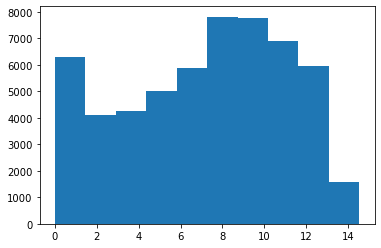

In [84]:
plt.hist(weather_total['sol'])

In [85]:
weather_total['sol'].describe()

count   55517.000
mean        7.158
std         3.856
min         0.000
25%         4.100
50%         7.717
75%        10.271
max        14.533
Name: sol, dtype: float64

In [86]:
def codificar_sol(weather_file):
    #Based on the visualization of the data and the understaindg that we are talking about hours of sun (higher in summer, but high anyhow from 8 onwards):
    bins =    [0, 2.25, 4.50, 6.75, 9.00, 15.00]
    weather_file['sol_new'] = pd.cut(weather_file['sol'], bins = bins, labels = [1, 2, 3, 4, 5])
    weather_file = weather_file.drop(columns = 'sol', axis = 1)
    weather_file = weather_file.rename(columns = {'sol_new':'sol'})
    #We want it to be in numerical format
    weather_file['sol'] = weather_file['sol'].astype('float64')
    #It will return some NA valyes due to not be a closed intervals in btoh sides.    
    return weather_file

In [87]:
weather_total = codificar_sol(weather_total)

In [88]:
weather_total.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55517 entries, 0 to 55516
Data columns (total 13 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   fecha               55517 non-null  datetime64[ns]
 1   comunidad_autonoma  55517 non-null  object        
 2   CODAUTO             55517 non-null  int64         
 3   tmed                55517 non-null  float64       
 4   prec                55517 non-null  float64       
 5   tmin                55517 non-null  float64       
 6   tmax                55517 non-null  float64       
 7   dir                 55517 non-null  float64       
 8   velmedia            55517 non-null  float64       
 9   racha               55517 non-null  float64       
 10  AGUA_TOTAL          55517 non-null  float64       
 11  AGUA_ACTUAL         55517 non-null  float64       
 12  sol                 54173 non-null  float64       
dtypes: datetime64[ns](1), float64(10), int64(1), o

In [89]:
#Let's consolidate all these steps into a function:

def consolidate_weather_codpro_embalses(weather_file, codpro_file, embalses_file):

    #Crossing files:
    weather_complete = pd.merge(weather_file, codpro_file, how = 'left', on= 'provincia')
    weather_complete = pd.merge(weather_complete, embalses_file, how = 'left', on = ['fecha', 'provincia'])

    #Replacing NAs for water info:
    weather_complete['AGUA_TOTAL'] = weather_complete['AGUA_TOTAL'].fillna(0)
    weather_complete['AGUA_ACTUAL'] = weather_complete['AGUA_ACTUAL'].fillna(0)

    #Reducing dimensionality to CCAA:
    weather_complete = weather_complete.groupby(['fecha', 'comunidad_autonoma', 'CODAUTO'], as_index = False).agg(
    {'tmed': 'mean',
     'prec': 'mean',
     'tmin': 'mean',
     'tmax': 'mean',
     'dir': 'mean',
     'velmedia': 'mean',
     'racha': 'mean',
     'sol': 'mean',
     'AGUA_TOTAL': 'sum',
     'AGUA_ACTUAL': 'sum',}).round(3)
    
    #filling pending NA values
    
    float_cols = weather_complete.select_dtypes(include=['float64']).columns
    weather_complete[float_cols] = weather_complete[float_cols].fillna(0)

    return weather_complete

Now we are matching this info with generation file. However, some names have to be modified in generation file, otherwise is not going to work.

In [90]:
generation_dataframe.head()

,fecha,comunidad_autonoma,Eólica,Hidráulica,Solar fotovoltaica,Solar térmica
0,2015-01-01,ANDALUCIA,10798.051,1066.442,3949.598,3932.111
1,2015-01-01,ARAGON,9217.848,6469.745,609.142,0.000
2,2015-01-01,CANTABRIA,87.789,853.153,0.000,0.000
3,2015-01-01,CASTILLA Y LEON,17821.173,17774.025,1670.228,0.000
4,2015-01-01,CASTILLA- LA MANCHA,14924.135,1848.499,4539.090,1384.787


In [91]:
generation_dataframe['comunidad_autonoma'].unique() #(Ceuta is not there! we shoud remove it after)

array(['ANDALUCIA', 'ARAGON', 'CANTABRIA', 'CASTILLA Y LEON',
       'CASTILLA- LA MANCHA', 'CATALUNA', 'COMUNIDAD DE MADRID',
       'COMUNIDAD DE NAVARRA', 'COMUNIDAD MELILLA',
       'COMUNIDAD VALENCIANA', 'EXTREMADURA', 'GALICIA', 'ISLAS BALEARES',
       'ISLAS CANARIAS', 'LA RIOJA', 'PAIS VASCO',
       'PRINCIPADO DE ASTURIAS', 'REGION DE MURCIA'], dtype=object)

In [92]:
weather_total['comunidad_autonoma'].unique()

array(['ANDALUCIA', 'ARAGON', 'CANARIAS', 'CANTABRIA', 'CASTILLA Y LEON',
       'CASTILLA-LA MANCHA', 'CATALUNA', 'CEUTA', 'COMUNIDAD DE MADRID',
       'COMUNIDAD FORAL DE NAVARRA', 'COMUNITAT VALENCIANA',
       'EXTREMADURA', 'GALICIA', 'ILLES BALEARS', 'LA RIOJA', 'MELILLA',
       'PAIS VASCO', 'PRINCIPADO DE ASTURIAS', 'REGION DE MURCIA'],
      dtype=object)

In [93]:
def REE_ccaa_rename(dataframe):
    dataframe['comunidad_autonoma'] = dataframe['comunidad_autonoma'].replace({'CASTILLA- LA MANCHA': 'CASTILLA-LA MANCHA',
                                                                                          'COMUNIDAD DE NAVARRA': 'COMUNIDAD FORAL DE NAVARRA',
                                                                                          'COMUNIDAD MELILLA':'MELILLA',
                                                                                          'COMUNIDAD VALENCIANA': 'COMUNITAT VALENCIANA',
                                                                                          'ISLAS BALEARES': 'ILLES BALEARS',
                                                                                          'ISLAS CANARIAS': 'CANARIAS',
                                                                                          })
    return dataframe

In [94]:
generation_dataframe= REE_ccaa_rename(generation_dataframe)

In [95]:
#Let's combine finally! weather and generation data:

def consolidatet_generation_weather(weather_total_file, generation_file):

    #Let's drop Ceuta values from weather file:

    weather_total_file = weather_total_file[weather_total_file['comunidad_autonoma'] != 'CEUTA']

    consolidated_df = pd.merge(weather_total_file, generation_file, how = 'left', on = ['fecha', 'comunidad_autonoma'])

    return consolidated_df

    

In [96]:
consolidated_df = consolidatet_generation_weather(weather_total, generation_dataframe)

In [97]:
consolidated_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 52595 entries, 0 to 52594
Data columns (total 17 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   fecha               52595 non-null  datetime64[ns]
 1   comunidad_autonoma  52595 non-null  object        
 2   CODAUTO             52595 non-null  int64         
 3   tmed                52595 non-null  float64       
 4   prec                52595 non-null  float64       
 5   tmin                52595 non-null  float64       
 6   tmax                52595 non-null  float64       
 7   dir                 52595 non-null  float64       
 8   velmedia            52595 non-null  float64       
 9   racha               52595 non-null  float64       
 10  AGUA_TOTAL          52595 non-null  float64       
 11  AGUA_ACTUAL         52595 non-null  float64       
 12  sol                 51351 non-null  float64       
 13  Eólica              52595 non-null  float64   

In [98]:
consolidated_df.head(20)

,fecha,comunidad_autonoma,CODAUTO,tmed,prec,tmin,tmax,dir,velmedia,racha,AGUA_TOTAL,AGUA_ACTUAL,sol,Eólica,Hidráulica,Solar fotovoltaica,Solar térmica
0,2015-01-01,ANDALUCIA,1,8.434,0.000,1.429,15.422,22.818,2.400,8.297,80.440,51.390,4.000,10798.051,1066.442,3949.598,3932.111
1,2015-01-01,ARAGON,2,5.167,0.000,-2.033,12.383,29.417,1.818,8.428,2434.490,2006.580,4.000,9217.848,6469.745,609.142,0.000
2,2015-01-01,CANARIAS,5,17.250,0.000,15.012,19.519,44.292,4.779,12.431,0.000,0.000,2.000,702.312,0.000,687.741,0.000
3,2015-01-01,CANTABRIA,6,7.357,0.000,1.100,13.657,35.500,1.867,5.083,108.100,73.410,4.000,87.789,853.153,0.000,0.000
4,2015-01-01,CASTILLA Y LEON,7,4.191,0.000,-3.507,11.926,26.646,1.653,5.680,5001.480,4029.590,4.000,17821.173,17774.025,1670.228,0.000
5,2015-01-01,CASTILLA-LA MANCHA,8,3.808,0.000,-4.004,11.616,17.677,1.124,5.523,201.510,147.160,4.000,14924.135,1848.499,4539.090,1384.787
6,2015-01-01,CATALUNA,9,5.164,0.000,-0.615,10.935,40.854,1.715,6.598,417.400,363.000,4.000,6408.599,10451.127,825.289,51.288
7,2015-01-01,COMUNIDAD DE MADRID,13,4.682,0.000,-2.536,11.900,22.667,0.878,5.722,0.000,0.000,4.000,0.000,284.384,196.497,0.000
8,2015-01-01,COMUNIDAD FORAL DE NAVARRA,15,5.883,0.000,-2.383,14.150,37.200,1.600,9.900,43.780,34.950,4.000,4740.608,1635.210,609.142,0.000
9,2015-01-01,COMUNITAT VALENCIANA,10,7.670,0.000,1.302,14.046,19.722,1.805,6.128,138.360,118.100,4.000,5706.287,782.057,1395.132,222.250


### 1.5 Demand Data

There is still one last target we want to predict, which is the energetic demand, in order to see  how much of that demand could be covered by the renovable production expected in accordance to our model.
It is possible to obtain demand data also from REE, and it would be useful to download it also by CCAA in order to have it in the same structure that the generation and weather data.

The demand files will include the information of the date (in a motnhly or daily basis) and the demand'Demanda b.C' in MWh, which means '"Demand at p.s. (power station bars)
Energy injected into the network from generation plants and imports, minus pumping consumption and exports."

In [99]:
#First of all, let's download the information related to the total demand in a daily basis:

def data_REE_demand(yearini, yearend): # -> REE API Only allows to extract data in a yearly basis

     #First we get the response from REE (It only allow us to see one year each time)

    years = range(yearini,yearend + 1)
    data_consolidated = pd.DataFrame(columns= ['value', 'percentage', 'datetime'])

    for year in years:

        demand = requests.get(f"https://apidatos.ree.es/es/datos/demanda/evolucion?start_date={year}-01-01T00:00&end_date={year}-12-31T23:59&time_trunc=day")

        #Data comes in a json with dictionaries inside. To access to the data we have to proccess it a little bit with json and dictionary methods.

        demand = demand.json()['included']
        demand = pd.DataFrame.from_dict(demand)['attributes']
        demand = pd.json_normalize(demand)
        demand = demand['values']

        #We create a for loop in order to access to all data in the dicionary and to get the complete list for all the energetic resources

        for value in demand:
    
            data = pd.DataFrame.from_dict(value)
            data_consolidated = pd.concat([data_consolidated, data])

    #Let's take the opportunity for already preparing the field 'month' in order to cross the file afterwards:

    data_consolidated['datetime'] = data_consolidated['datetime'].str[:10]
    data_consolidated['datetime'] = pd.to_datetime(data_consolidated['datetime'])
    data_consolidated['month'] = data_consolidated['datetime'].dt.to_period('M')

    return data_consolidated

In [100]:
#demand_daily.to_csv('./Data/Demand/Demand_2015_2022.csv')

In [164]:
demand_daily = drive_read_file(url_demand)


In [165]:
def transform_demand_daily(demand_daily_file):
    demand_daily_file = demand_daily_file.drop(columns = 'Unnamed: 0')
    demand_daily_file['datetime'] = pd.to_datetime(demand_daily_file['datetime'])
    demand_daily_file['month'] = demand_daily_file['datetime'].dt.to_period('M')
    return demand_daily_file



In [166]:
demand_daily = transform_demand_daily(demand_daily)

In [167]:
demand_daily.head()

,value,percentage,datetime,month
0,603961.474,1,2015-01-01,2015-01
1,715038.679,1,2015-01-02,2015-01
2,698648.512,1,2015-01-03,2015-01
3,663533.254,1,2015-01-04,2015-01
4,714784.323,1,2015-01-05,2015-01


In [168]:
demand_daily.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2922 entries, 0 to 2921
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   value       2922 non-null   float64       
 1   percentage  2922 non-null   int64         
 2   datetime    2922 non-null   datetime64[ns]
 3   month       2922 non-null   period[M]     
dtypes: datetime64[ns](1), float64(1), int64(1), period[M](1)
memory usage: 91.4 KB


In [169]:
def data_REE_demand_by_CCAA(yearini, yearend): # -> REE API Only allows to extract data in a yearly basis

     #First we get the response from REE (It only allow us to see one year each time)

    years = range(yearini,yearend + 1)

    data_consolidated = pd.DataFrame(columns= ['comunidad_autonoma', 'month', 'demand_ccaa'])
    
    all_data = []

    
    for year in years:

        
        demand = requests.get(f"https://apidatos.ree.es/es/datos/demanda/evolucion?start_date={year}-01-01T00:00&end_date={year}-12-31T23:59&time_trunc=month&all_ccaa=allCcaa")

        #Data comes in a json with dictionaries inside. To access to the data we have to proccess it a little bit with json and dictionary methods.
        
        demand = demand.json()['included']
        for element in demand:
            comunidad_autonoma = element['community_name']
            
            for attribute in element['content']['attributes']['values']:
                month = attribute['datetime']
                demand_ccaa = attribute['value']
                all_data.append({
                    'comunidad_autonoma': comunidad_autonoma,
                    'month': month,
                    'demand_ccaa': demand_ccaa
                })
        time.sleep(3.0)
    # Create a DataFrame from all the collected data
    data_consolidated = pd.DataFrame(all_data)

    return data_consolidated

In [170]:
#Let's get the information of the demand by CCAA for the years range we are interested in:
#demand_by_CCAA = data_REE_demand_by_CCAA(2015,2022) In case we do not have the file downloaded


In [171]:
demand_by_CCAA = drive_read_file(url_demand_by_ccaa).drop(columns = 'Unnamed: 0')

In [172]:
demand_by_CCAA.tail(20)

,comunidad_autonoma,month,demand_ccaa
1900,País Vasco,2022-05-01T00:00:00.000+02:00,1348281.478
1901,País Vasco,2022-06-01T00:00:00.000+02:00,1312495.187
1902,País Vasco,2022-07-01T00:00:00.000+02:00,1279878.110
1903,País Vasco,2022-08-01T00:00:00.000+02:00,994593.405
1904,País Vasco,2022-09-01T00:00:00.000+02:00,1226517.015
1905,País Vasco,2022-10-01T00:00:00.000+02:00,1278127.654
1906,País Vasco,2022-11-01T00:00:00.000+01:00,1280926.034
1907,País Vasco,2022-12-01T00:00:00.000+01:00,1200907.471
1908,Todas,2022-01-01T00:00:00.000+01:00,22729295.932
1909,Todas,2022-02-01T00:00:00.000+01:00,20168155.371


In [173]:
demand_by_CCAA.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1920 entries, 0 to 1919
Data columns (total 3 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   comunidad_autonoma  1920 non-null   object 
 1   month               1920 non-null   object 
 2   demand_ccaa         1920 non-null   float64
dtypes: float64(1), object(2)
memory usage: 45.1+ KB


In [174]:
#Let's transform demand_by_CCAA file in roder to match it with the other files as we have made with generation files:

def demand_by_CCAA_process(demand_by_CCAA_file):
    
    #We are not including the total 'todas' in the final df. Naames can be updated already:

    demand_by_CCAA_file = demand_by_CCAA_file[demand_by_CCAA_file['comunidad_autonoma'] != 'Todas']
    demand_by_CCAA_file['comunidad_autonoma'] = demand_by_CCAA_file['comunidad_autonoma'].apply(unidecode).str.upper()

    #First we need 'month' in a format we can match:
    demand_by_CCAA_file['month'] = demand_by_CCAA_file['month'].str[:10]
    demand_by_CCAA_file['month'] = pd.to_datetime(demand_by_CCAA_file['month'])
    demand_by_CCAA_file['month'] = demand_by_CCAA_file['month'].dt.to_period('M')

    #Now we create the column 'percentage' from the same dataframe, by dividing each CCAA per total for each month.

    demand_by_CCAA_file_A = demand_by_CCAA_file.groupby('month')['demand_ccaa'].sum()
    demand_by_CAA_total = pd.merge(demand_by_CCAA_file, demand_by_CCAA_file_A, how = 'left', on = 'month')
    demand_by_CAA_total['percentage'] = demand_by_CAA_total['demand_ccaa_x']/demand_by_CAA_total['demand_ccaa_y']


    return demand_by_CAA_total

In [175]:
demand_by_CCAA_percent = demand_by_CCAA_process(demand_by_CCAA)
demand_by_CCAA_percent.head(13)

/tmp/ipykernel_11466/2639149916.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  demand_by_CCAA_file['comunidad_autonoma'] = demand_by_CCAA_file['comunidad_autonoma'].apply(unidecode).str.upper()
/tmp/ipykernel_11466/2639149916.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  demand_by_CCAA_file['month'] = demand_by_CCAA_file['month'].str[:10]
/tmp/ipykernel_11466/2639149916.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,c

,comunidad_autonoma,month,demand_ccaa_x,demand_ccaa_y,percentage
0,ANDALUCIA,2015-01,3485428.721,23850778.392,0.146
1,ANDALUCIA,2015-02,3167179.074,22079124.472,0.143
2,ANDALUCIA,2015-03,3150607.517,22320622.586,0.141
3,ANDALUCIA,2015-04,2809896.497,19913745.873,0.141
4,ANDALUCIA,2015-05,3047140.450,21024441.899,0.145
5,ANDALUCIA,2015-06,3184114.599,21582825.533,0.148
6,ANDALUCIA,2015-07,3923735.479,24945739.096,0.157
7,ANDALUCIA,2015-08,3621936.219,22320043.772,0.162
8,ANDALUCIA,2015-09,3034131.643,20847347.155,0.146
9,ANDALUCIA,2015-10,2956529.323,20958912.989,0.141


In [176]:
demand_by_CCAA_percent.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1824 entries, 0 to 1823
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype    
---  ------              --------------  -----    
 0   comunidad_autonoma  1824 non-null   object   
 1   month               1824 non-null   period[M]
 2   demand_ccaa_x       1824 non-null   float64  
 3   demand_ccaa_y       1824 non-null   float64  
 4   percentage          1824 non-null   float64  
dtypes: float64(3), object(1), period[M](1)
memory usage: 85.5+ KB


In [177]:
#Let's check if it has worked:
demand_by_CCAA_percent.groupby('month')['percentage'].sum()

month
2015-01   1.000
2015-02   1.000
2015-03   1.000
2015-04   1.000
2015-05   1.000
           ... 
2022-08   1.000
2022-09   1.000
2022-10   1.000
2022-11   1.000
2022-12   1.000
Freq: M, Name: percentage, Length: 96, dtype: float64

All the information related to demand is ready, it is only necessary to cross the files between them and, afterwards, to cross it with 'consolidated_df' file:

In [178]:
def cross_demand_files (demand_file, demand_by_CCAA_file_processed):
    
    #We are creating a list with the information of the CCAA:
    

    ccaa_list =  list(demand_by_CCAA_file_processed['comunidad_autonoma'].unique())
    range_dates = pd.date_range(demand_file['datetime'].min(), demand_file['datetime'].max(), freq= 'd')

    #For each day we are creating a new dataframe with several rows based on CCAA:
    new_list = []

    for fecha in range_dates:
        for ccaa in ccaa_list:
            new_list.append({'datetime': fecha, 'comunidad_autonoma': ccaa})

    demand_total = pd.DataFrame(new_list)
    demand_total['datetime'] = pd.to_datetime(demand_total['datetime'])
    #It is not necessary to have 'percentage' or te values of the monthly demand on the files:

    demand_file = demand_file.drop(columns = 'percentage', axis = 1)
    demand_by_CCAA_file_processed = demand_by_CCAA_file_processed.drop(columns = ['demand_ccaa_x', 'demand_ccaa_y'], axis = 1)

    #The template with the columns to fulfilled has been created. Now we have to match it with the other files:

    demand_total = pd.merge(demand_total, demand_file, how = 'left', on = 'datetime')
    demand_total = pd.merge(demand_total, demand_by_CCAA_file_processed, how = 'left', on = ['comunidad_autonoma','month'])
    demand_total['value_ccaa'] = (demand_total['percentage']*demand_total['value']).round(3)
    

    #Let's clean a little bit the file:

    demand_total = demand_total.rename(columns = {'datetime':'fecha',
                                                  'value_ccaa': 'demand_ccaa'})   
    
    demand_total = demand_total.drop(columns = ['value', 'month', 'percentage'])

    #Let's create a binary column that indicates if the day is a weekday or not, as it can be important for the anaysis:

    demand_total['Weekday'] = demand_total['fecha'].dt.day_name().apply(lambda x:1 if x in ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday'] else 0)
    

    return demand_total

In [181]:
demand_total = cross_demand_files(demand_daily, demand_by_CCAA_percent)

In [182]:
demand_total

,fecha,comunidad_autonoma,demand_ccaa,Weekday
0,2015-01-01,ANDALUCIA,88259.789,1
1,2015-01-01,ARAGON,22882.569,1
2,2015-01-01,PRINCIPADO DE ASTURIAS,24214.850,1
3,2015-01-01,CANTABRIA,9493.101,1
4,2015-01-01,CASTILLA- LA MANCHA,27083.707,1
...,...,...,...,...
55513,2022-12-31,LA RIOJA,3574.873,0
55514,2022-12-31,COMUNIDAD MELILLA,418.708,0
55515,2022-12-31,REGION DE MURCIA,19444.388,0
55516,2022-12-31,COMUNIDAD DE NAVARRA,10734.124,0


In [183]:
#We need to transform again 'comunidad_autontoma', otherwise it will fail. We can use a functionwe already created before for generation file:

demand_total = REE_ccaa_rename(demand_total)
demand_total

,fecha,comunidad_autonoma,demand_ccaa,Weekday
0,2015-01-01,ANDALUCIA,88259.789,1
1,2015-01-01,ARAGON,22882.569,1
2,2015-01-01,PRINCIPADO DE ASTURIAS,24214.850,1
3,2015-01-01,CANTABRIA,9493.101,1
4,2015-01-01,CASTILLA-LA MANCHA,27083.707,1
...,...,...,...,...
55513,2022-12-31,LA RIOJA,3574.873,0
55514,2022-12-31,MELILLA,418.708,0
55515,2022-12-31,REGION DE MURCIA,19444.388,0
55516,2022-12-31,COMUNIDAD FORAL DE NAVARRA,10734.124,0


In [184]:
#For merging the file we can use a funciton that we already created for generation:

consolidated_df = consolidatet_generation_weather(consolidated_df, demand_total)

#### Now we finally have the full dataset we are going to work with :)

In [185]:
consolidated_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 52595 entries, 0 to 52594
Data columns (total 19 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   fecha               52595 non-null  datetime64[ns]
 1   comunidad_autonoma  52595 non-null  object        
 2   CODAUTO             52595 non-null  int64         
 3   tmed                52595 non-null  float64       
 4   prec                52595 non-null  float64       
 5   tmin                52595 non-null  float64       
 6   tmax                52595 non-null  float64       
 7   dir                 52595 non-null  float64       
 8   velmedia            52595 non-null  float64       
 9   racha               52595 non-null  float64       
 10  AGUA_TOTAL          52595 non-null  float64       
 11  AGUA_ACTUAL         52595 non-null  float64       
 12  sol                 51351 non-null  float64       
 13  Eólica              52595 non-null  float64   

In [186]:
consolidated_df.head(15)

,fecha,comunidad_autonoma,CODAUTO,tmed,prec,tmin,tmax,dir,velmedia,racha,AGUA_TOTAL,AGUA_ACTUAL,sol,Eólica,Hidráulica,Solar fotovoltaica,Solar térmica,demand_ccaa,Weekday
0,2015-01-01,ANDALUCIA,1,8.434,0.000,1.429,15.422,22.818,2.400,8.297,80.440,51.390,4.000,10798.051,1066.442,3949.598,3932.111,88259.789,1
1,2015-01-01,ARAGON,2,5.167,0.000,-2.033,12.383,29.417,1.818,8.428,2434.490,2006.580,4.000,9217.848,6469.745,609.142,0.000,22882.569,1
2,2015-01-01,CANARIAS,5,17.250,0.000,15.012,19.519,44.292,4.779,12.431,0.000,0.000,2.000,702.312,0.000,687.741,0.000,18441.931,1
3,2015-01-01,CANTABRIA,6,7.357,0.000,1.100,13.657,35.500,1.867,5.083,108.100,73.410,4.000,87.789,853.153,0.000,0.000,9493.101,1
4,2015-01-01,CASTILLA Y LEON,7,4.191,0.000,-3.507,11.926,26.646,1.653,5.680,5001.480,4029.590,4.000,17821.173,17774.025,1670.228,0.000,32044.289,1
5,2015-01-01,CASTILLA-LA MANCHA,8,3.808,0.000,-4.004,11.616,17.677,1.124,5.523,201.510,147.160,4.000,14924.135,1848.499,4539.090,1384.787,27083.707,1
6,2015-01-01,CATALUNA,9,5.164,0.000,-0.615,10.935,40.854,1.715,6.598,417.400,363.000,4.000,6408.599,10451.127,825.289,51.288,105513.152,1
7,2015-01-01,COMUNIDAD DE MADRID,13,4.682,0.000,-2.536,11.900,22.667,0.878,5.722,0.000,0.000,4.000,0.000,284.384,196.497,0.000,70539.505,1
8,2015-01-01,COMUNIDAD FORAL DE NAVARRA,15,5.883,0.000,-2.383,14.150,37.200,1.600,9.900,43.780,34.950,4.000,4740.608,1635.210,609.142,0.000,10797.788,1
9,2015-01-01,COMUNITAT VALENCIANA,10,7.670,0.000,1.302,14.046,19.722,1.805,6.128,138.360,118.100,4.000,5706.287,782.057,1395.132,222.250,60570.766,1


### 1.6 Data Visualization

After compilling and consolidating all the information from the different sources, it is time to use 'matplotlib' & 'seaborn' libraries to plot the data in order to achieve a better understanding of the figures we are analyzing.
It is going to be a good way to already identify which variables are the most relevant to explain the generation of each energetic technology, and also to see if 'demand' is dependant of some of teh weather variables that are included in the dataframe.
First of all, we are utilizing also 'pandas profiling' as a first step to watch the relation between the variables on the dataset.


In [187]:
#Let's create the Pandas Profile to see if we can extract some conclusions:
pandas_profiling.ProfileReport(consolidated_df)

Render HTML: 100%|██████████| 1/1 [00:09<00:00,  9.39s/it]


The main conclussion that we can get from the 'Pandas Profile' is that the zero_values are so high in several generation target variables. This is due to the fact that we have included all the 'Comunidades Autónomas' for each day, but each technology is developed or focused on several CCAAs, not in all of them. A good procedure, then, would be to treate in different dataframes teh different technoglies from this point onwards as we were doing with the other notebooks as the first steps of teh project. That would help to better identify which variables have more impact for each technology, and would be easier to create the models.

Some conclusions related to the variables affecting to the production of each technology that can be extracted from the heat map from below of the Pandas Profile: :

    - Solar Fotovoltraica: Seems to be related tp 'sol' - that was expected-  an temperature variables, but it also has an interesting negative relation with prec and wind. Prec is obvious, but it is wind related to colienality or it is related to some topics like the pones explained in this article?: https://www.tecnicaindustrial.es/el-viento-principal-problema-al-que-se-enfrentan-las-plantas-fotovoltaicas/ We are maintaining wind variables.
    - SOlar Térmica: quite similar relations to Solar Fotovoltaica.
    - Eólica: Related to wind variables and 'prec'. We will have to analyze the picture per CCAA to have a better understanding.
    - Hidráulica: Directly related to the information we received ffrom the dams ('AGUA_ACTUAL' & AGUA_TOTAL') and temperature.
    - Demand: Related to temperature and also to 'weekday'

In [188]:
#Firstly to check if 'solar térmica' productive CCAAs are included in 'solar fotovoltaica' productive CCAAs so we can just create one filter
consolidated_df[consolidated_df['Solar térmica'] != 0]['comunidad_autonoma'].unique()

array(['ANDALUCIA', 'CASTILLA-LA MANCHA', 'CATALUNA',
       'COMUNITAT VALENCIANA', 'EXTREMADURA', 'REGION DE MURCIA'],
      dtype=object)

In [189]:
consolidated_df[consolidated_df['Solar fotovoltaica'] != 0]['comunidad_autonoma'].unique()

array(['ANDALUCIA', 'ARAGON', 'CANARIAS', 'CASTILLA Y LEON',
       'CASTILLA-LA MANCHA', 'CATALUNA', 'COMUNIDAD DE MADRID',
       'COMUNIDAD FORAL DE NAVARRA', 'COMUNITAT VALENCIANA',
       'EXTREMADURA', 'GALICIA', 'ILLES BALEARS', 'LA RIOJA',
       'PAIS VASCO', 'REGION DE MURCIA'], dtype=object)

In [190]:
#Let's filter the data:

def filter_consolidated_df(consolidated_file):

    ccaa_solartermica = consolidated_file[consolidated_file['Solar térmica'] != 0]['comunidad_autonoma'].unique()
    ccaa_solarfotovoltaica = consolidated_file[consolidated_file['Solar fotovoltaica'] != 0]['comunidad_autonoma'].unique()
    ccaa_hidraulica = consolidated_file[consolidated_file['Eólica'] != 0]['comunidad_autonoma'].unique()
    ccaa_eolica = consolidated_file[consolidated_file['Hidráulica'] != 0]['comunidad_autonoma'].unique()

    #Based on the information provided by the Pndas Profile and the other notebooks, we can drop alredy some variables that we know are not relevant for each technology:
    
    df_solartermica = consolidated_file[consolidated_file['comunidad_autonoma'].isin(ccaa_solartermica)] \
                                        .drop(columns = ['Solar fotovoltaica', 'Eólica', 'Hidráulica', 'demand_ccaa', 'CODAUTO','racha', 'dir','prec', 'Weekday', 'AGUA_TOTAL', 'AGUA_ACTUAL'], axis = 1) \
                                        .rename(columns = {'Solar térmica':'generation'})
    df_solarfotovoltaica = consolidated_file[consolidated_file['comunidad_autonoma'].isin(ccaa_solarfotovoltaica)] \
                                        .drop(columns = ['Solar térmica', 'Eólica', 'Hidráulica','demand_ccaa', 'CODAUTO', 'prec', 'dir', 'racha', 'Weekday', 'AGUA_TOTAL', 'AGUA_ACTUAL'], axis = 1) \
                                        .rename(columns = {'Solar fotovoltaica':'generation'})
    df_hidraulica = consolidated_file[consolidated_file['comunidad_autonoma'].isin(ccaa_hidraulica)] \
                                        .drop(columns = ['Solar fotovoltaica', 'Solar térmica', 'Eólica', 'demand_ccaa', 'CODAUTO', 'Weekday'], axis = 1) \
                                        .rename(columns = {'Hidráulica':'generation'})
    df_eolica = consolidated_file[consolidated_file['comunidad_autonoma'].isin(ccaa_eolica)] \
                                        .drop(columns = ['Solar fotovoltaica', 'Solar térmica', 'Hidráulica', 'demand_ccaa', 'CODAUTO', 'Weekday'], axis = 1) \
                                        .rename(columns = {'Eólica':'generation'})
    df_demand = consolidated_file.drop(columns = ['Solar fotovoltaica', 'Solar térmica', 'Hidráulica', 'Eólica', 'CODAUTO'], axis = 1)

    return df_solartermica, df_solarfotovoltaica, df_hidraulica, df_eolica, df_demand


    

In [191]:
df_solartermica, df_solarfotovoltaica, df_hidraulica, df_eolica, df_demand = filter_consolidated_df(consolidated_df)

In [192]:
#As we can see there are many less values now.This wil help in the anaylisis:
df_solartermica.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 17532 entries, 0 to 52594
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   fecha               17532 non-null  datetime64[ns]
 1   comunidad_autonoma  17532 non-null  object        
 2   tmed                17532 non-null  float64       
 3   tmin                17532 non-null  float64       
 4   tmax                17532 non-null  float64       
 5   velmedia            17532 non-null  float64       
 6   sol                 17488 non-null  float64       
 7   generation          17532 non-null  float64       
dtypes: datetime64[ns](1), float64(6), object(1)
memory usage: 1.2+ MB


#### 1.6.1 Solar Fotovoltaica

In [193]:
def plot_correlation(df):
    cols_not_to_plot = ['fecha', 'CODAUTO']
    cols_to_plot = [col for col in df.columns if col not in cols_not_to_plot]
    sns.pairplot(df[cols_to_plot],diag_kind='hist')

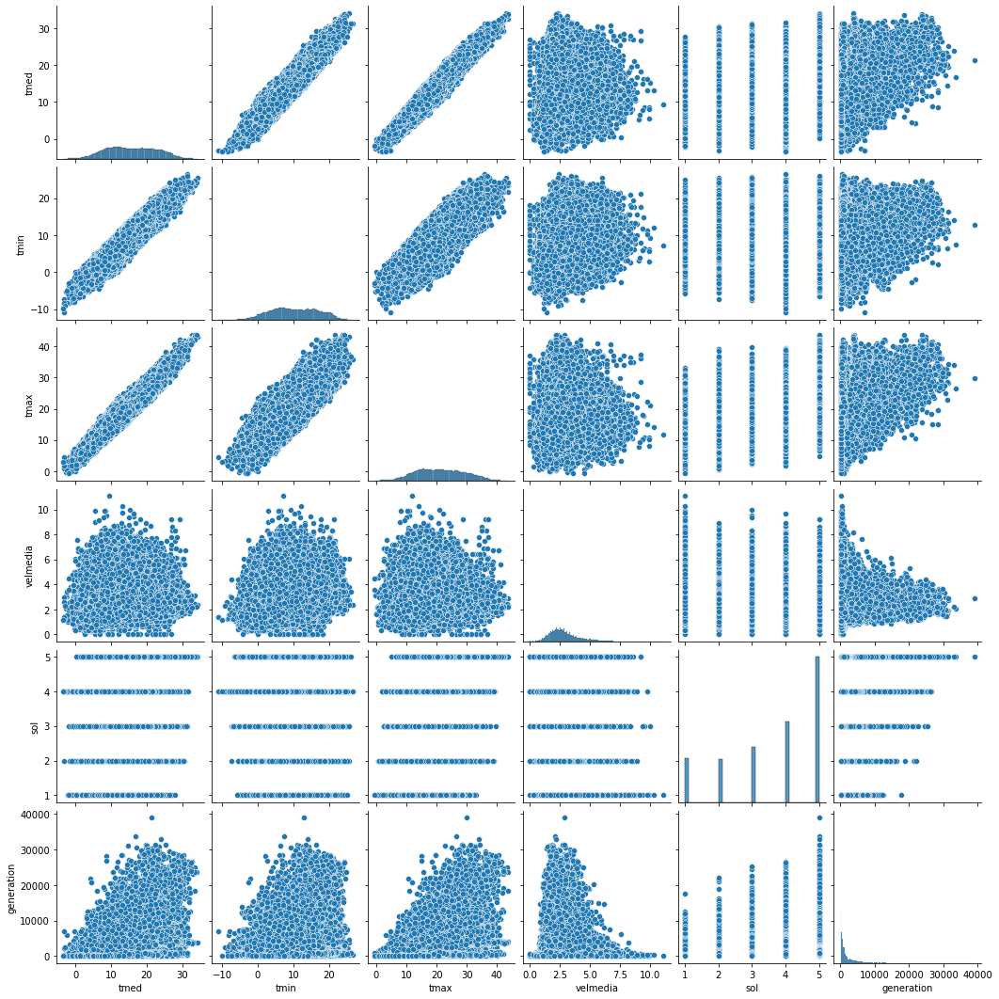

In [194]:
plot_correlation(df_solarfotovoltaica)

It is a similar plot to the heat map we have seen in Pandas Profile. therefore, the conclusions 'apparently' were right and seems to be a correlation between the choosen variables. Let's replicate now the heatmap for this technology:

In [195]:
def plot_heatmap(df):
    
    cols_not_to_plot = ['fecha', 'CODAUTO', 'comunidad_autonoma']
    cols_to_plot = [col for col in df.columns if col not in cols_not_to_plot]
    corr = df[cols_to_plot].corr()
    sns.heatmap(corr,
                cmap='crest',
                linewidth = .2)
    plt.show()

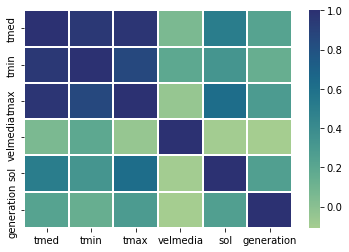

In [196]:
plot_heatmap(df_solarfotovoltaica)

In [197]:
f = df_solarfotovoltaica[df_solarfotovoltaica['fecha'].dt.year == 2015]
f.groupby(f['fecha'].dt.month)['generation'].sum()

fecha
1    517921.807
2    494227.521
3    713261.819
4    755910.118
5    925016.523
6    890984.637
7    934090.860
8    831069.095
9    722926.132
10   537173.900
11   529698.663
12   392962.110
Name: generation, dtype: float64

Let's see how the distribution of energetic production is during the years:

In [198]:
def plot_generation_evolution(dataframe):

    years = dataframe['fecha'].dt.year.unique()

    plt.figure(figsize = (12,6))

    for year in years:
    
        year_data = dataframe[dataframe['fecha'].dt.year == year]
        year_monthly_sum = year_data.groupby(year_data['fecha'].dt.month)['generation'].sum()
        plt.plot(year_monthly_sum.index, year_monthly_sum.values, label=year)
    plt.xlabel('Month')
    plt.ylabel('Energetic production')
    plt.legend()
    plt.grid(True)
    plt.title(f'Evolution of generation', fontsize=16)
    plt.show()


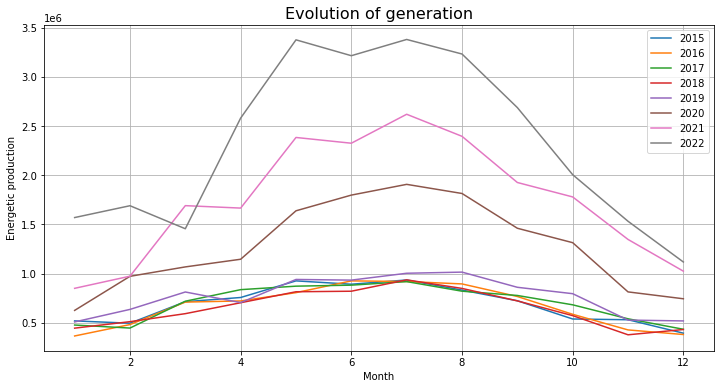

In [199]:
plot_generation_evolution(df_solarfotovoltaica)

It is a good way to see how the evolution of the generation perform during the year and its specially high during the summer months.
The plot helps also to see how this energy has grown these last years.

In [200]:
def plot_cca_by_year(dataframe):

    fig, axs = plt.subplots(1,2, figsize = (20,8))

    dataframe['year'] = dataframe['fecha'].dt.year
    dataframe['month'] = dataframe['fecha'].dt.month
    sum_values = dataframe.groupby(['year','comunidad_autonoma'])['generation'].sum() \
                            .reset_index()
    
    
    sns.swarmplot( data = sum_values, x = 'year', y = 'generation', hue= 'comunidad_autonoma',ax = axs[0])
    axs[0].set_title('Generation by CCAA')
    axs[0].set_ylabel('generation MWh')

    sum_values = sum_values.replace({'CASTILLA Y LEON':'CYLE'}) #n order to avoid mixing it with the other 'Castilla' in the next step.
    sum_values['com_short'] = sum_values['comunidad_autonoma'].str[:4]
    sns.barplot( data = sum_values, x = 'com_short', y = 'generation', hue= 'year', ax = axs[1])
    axs[1].set_title('Generation by CCAA')
    axs[1].set_ylabel('generation MWh')

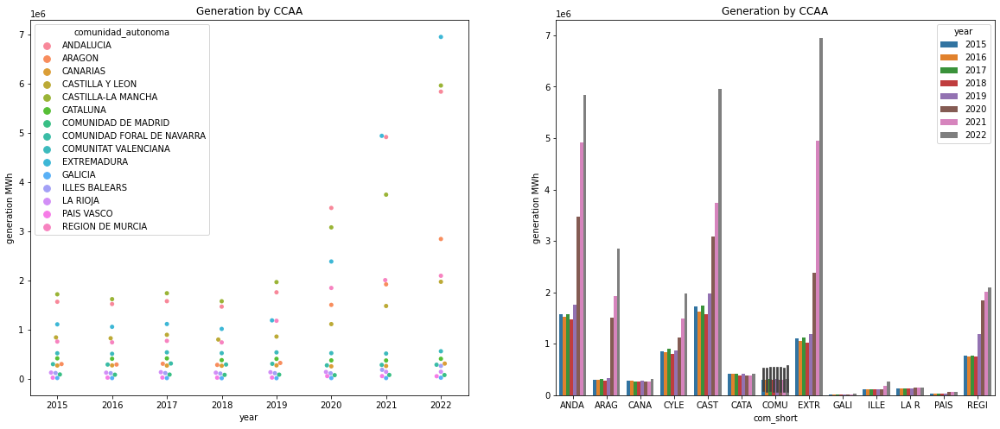

In [201]:
plot_cca_by_year(df_solarfotovoltaica)

It is already possible to see which are the main CCAAs in terms of production: Andalucia, Castilla-lA Mancha and Extremadura ae the leaders, but Aragon is growing so fast also.

In [3]:
#With geopandas library we can access to geometry data, which will help us to create plots using a map as template!

def drive_read_gpd_file(url):
    
    file = 'https://drive.google.com/uc?id=' + url.split('/')[-2]
    file = requests.get(file)
    # Use BytesIO to handle the zip file in memory
    zip_file = zipfile.ZipFile(BytesIO(file.content))
    
    # Create an in-memory named file for each file in the zip file
    files = {name: zip_file.open(name) for name in zip_file.namelist()}
    
    # Read the shapefile from the in-memory file
    mapplot = gpd.read_file(files[f'{zip_file.namelist()[0]}'])
    return mapplot

In [4]:
spain = drive_read_gpd_file(url_map)

In [5]:
def create_spain_map():
    #To access to the geo data we are using geopandas library, which transforms data into readable dataframes:
    spain = gpd.read_file('./Data/Plots/gadm41_ESP_1.shp')
    spain = spain.rename(columns = {'NAME_1': 'comunidad_autonoma', 'CC_1':'CODAUTO'})
    spain['comunidad_autonoma'] = (spain['comunidad_autonoma'].apply(unidecode, 'utf-8')).str.upper()
    spain['comunidad_autonoma'] = spain['comunidad_autonoma'].replace({'CEUTA Y MELILLA':'MELILLA',
                                                                    'COMUNIDAD VALENCIANA': 'COMUNITAT VALENCIANA',
                                                                    'ISLAS BALEARES': 'ILLES BALEARS',
                                                                    'ISLAS CANARIAS': 'CANARIAS'})
    
    #We don't need all the information from the file:

    spain = spain[['comunidad_autonoma', 'geometry']]

    return spain

In [6]:
spain = create_spain_map()

In [7]:
#The result is a dataframe with several columns, specially importants two of them: 'comunidad_autonoma' & 'geometry'
spain.head()

,comunidad_autonoma,geometry
0,ANDALUCIA,"MULTIPOLYGON (((-3.03125 35.94069, -3.03125 35..."
1,ARAGON,"POLYGON ((-0.81690 39.89858, -0.81272 39.89801..."
2,CANTABRIA,"MULTIPOLYGON (((-3.93629 42.90813, -3.93672 42..."
3,CASTILLA-LA MANCHA,"MULTIPOLYGON (((-1.45231 38.58182, -1.46655 38..."
4,CASTILLA Y LEON,"MULTIPOLYGON (((-5.62101 40.24145, -5.62189 40..."


In [8]:
spain.info(9)

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 18 entries, 0 to 17
Data columns (total 2 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   comunidad_autonoma  18 non-null     object  
 1   geometry            18 non-null     geometry
dtypes: geometry(1), object(1)
memory usage: 416.0+ bytes


<AxesSubplot:>

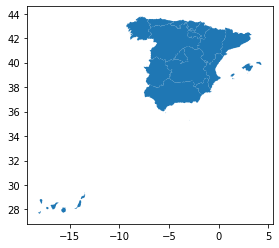

In [9]:
#It will be useful for easily create a map of Spain. The only problem is that Canariasis going to appear so far and therefore the map wil  be smaller than we want. We are 'canarias' coordinates in order to solve it:
spain.plot()

In [ ]:
def translate_canarias(spain_file):
    
    # Apply translate to 'geometry' column based on condition
    spain['geometry'] = spain.apply(
    lambda row: translate(row['geometry'], xoff=3, yoff=6) if row['comunidad_autonoma'] == 'CANARIAS' else row['geometry'],
    axis=1
    )

    return spain_file


In [ ]:
spain = translate_canarias(spain)

<AxesSubplot:>

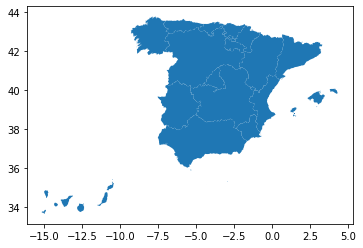

In [ ]:
#Let's quickly check:
spain.plot()

In [ ]:
def plot_map_generation(map_file, dataframe, year):

    dataframe = dataframe[dataframe['fecha'].dt.year == year]
    dataframe = dataframe.groupby('comunidad_autonoma')['generation'].sum()
    spain = pd.merge(map_file, dataframe, on='comunidad_autonoma', how='left').fillna(0)

    #Transform generation into GWh:

    spain['generation'] = spain['generation']/1000

    # Plot:
    fig, ax = plt.subplots(figsize=(14, 10))

    # Plot the boundaries between comunidades autónomas
    spain['geometry'].boundary.plot(ax=ax, linewidth=0.5, color='black')

    # Use ax parameter for both plots
    spain.plot(column='generation', legend=True, ax=ax, cmap = 'Blues')
    
    # Adjust the map limits
    ax.set_xlim(-16, 5) 
    ax.set_ylim(33, 45)

    plt.title(f'Generation of by CCAA in GWh, {year}')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.legend()
    plt.show()


No handles with labels found to put in legend.


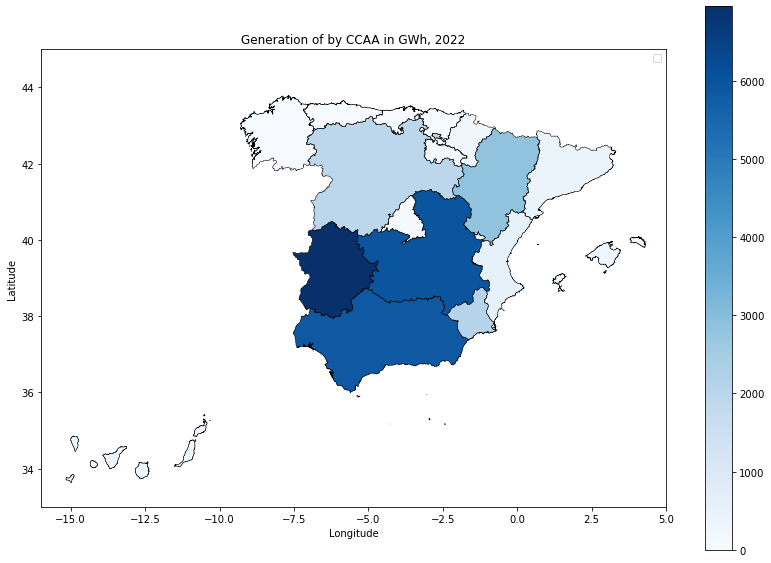

In [ ]:
plot_map_generation(spain, df_solarfotovoltaica, 2022)

It is always easier to visualize data on a map. The conclusion would be that tis technology is specially productive in the south of Spain - which obviously makes sense. We are creating now a plot to see the same map but with the other variables also to see if they are correlated.

In [ ]:
def plot_map_generation_withvariables(map_file, dataframe, year):

    cols_to_plot = [column for column in dataframe.columns if dataframe[column].dtype == 'float64']

    dataframe = dataframe[dataframe['fecha'].dt.year == year]
    dataframe = dataframe.groupby('comunidad_autonoma').mean()

    # Plot:
    nrows = (1 if 0 < len(cols_to_plot) < 3
             else 2 if 2 < len(cols_to_plot) < 5
             else 3)
    ncols = 2
    r = 0
    c = 0
    #Plots
    fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(14, 10))

    for i, column in enumerate(cols_to_plot):
            
        df = dataframe.groupby('comunidad_autonoma')[column].mean()
        df = pd.merge(map_file, df, on='comunidad_autonoma', how='left').fillna(0)
        

        # Plot the boundaries between comunidades autónomas
        df['geometry'].boundary.plot(ax=ax[i // ncols, i % ncols], linewidth=0.5, color='black')

        # Use ax parameter for both plots
        df.plot(column=column, legend=True, ax=ax[i // ncols, i % ncols], cmap='Blues')
            
        # Adjust the map limits
        ax[i // ncols, i % ncols].set_xlim(-16, 5) 
        ax[i // ncols, i % ncols].set_ylim(33, 45)

        ax[i // ncols, i % ncols].set_title(f'{column} by CCAA in {year}')
        ax[i // ncols, i % ncols].set_xlabel('Longitude')
        ax[i // ncols, i % ncols].set_ylabel('Latitude')
  
    if len(cols_to_plot) % 2 != 0:
        plt.delaxes(ax[nrows-1, ncols-1])
    plt.tight_layout()
    plt.show()


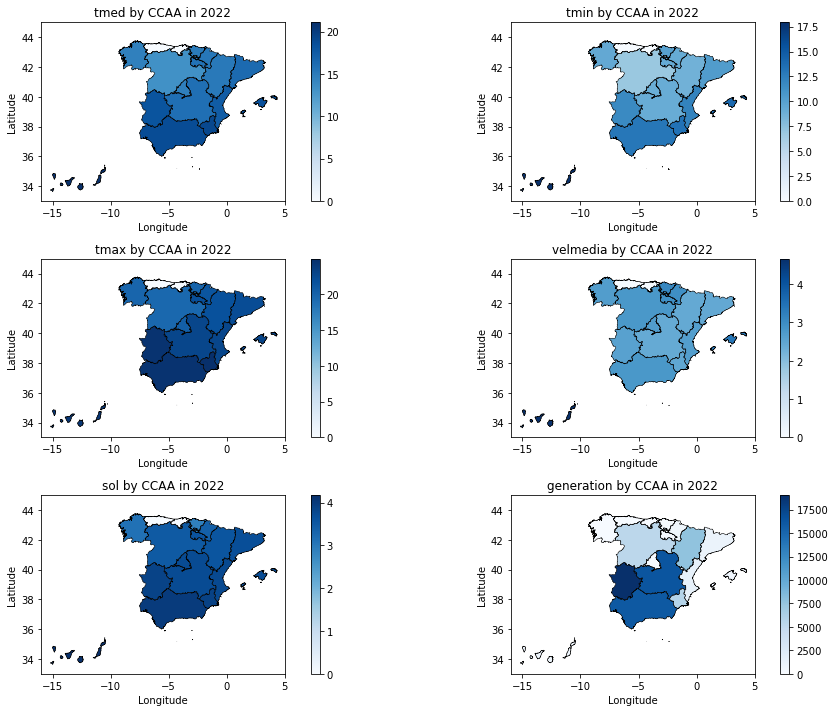

In [ ]:
plot_map_generation_withvariables(spain,df_solarfotovoltaica, 2022)

The plots seem to confirm at first sight the hypothesis we had: 'temperature' and 'sol' are variables highly correlated with photovoltaic solar generation. We will maintain also 'velmedoa' for the study as it seems to make sense also.

#### 1.6.2 Solar Térmica

'Solar térmica' has a smaller generation in Spain and the CCAA with production are fewer also. However, it's probably worthy to analyze it spearatrely from 'solar fotovoltaica' as the technolgy is different and therefore the variables affecting to the generation can vary or affect in a different manner in this case. \
We are inclusing here the same plots we have used for 'solar fotovoltaica'.

First of all, the correllation plots in order to confirm if the variables selected actually have an impact on generation:

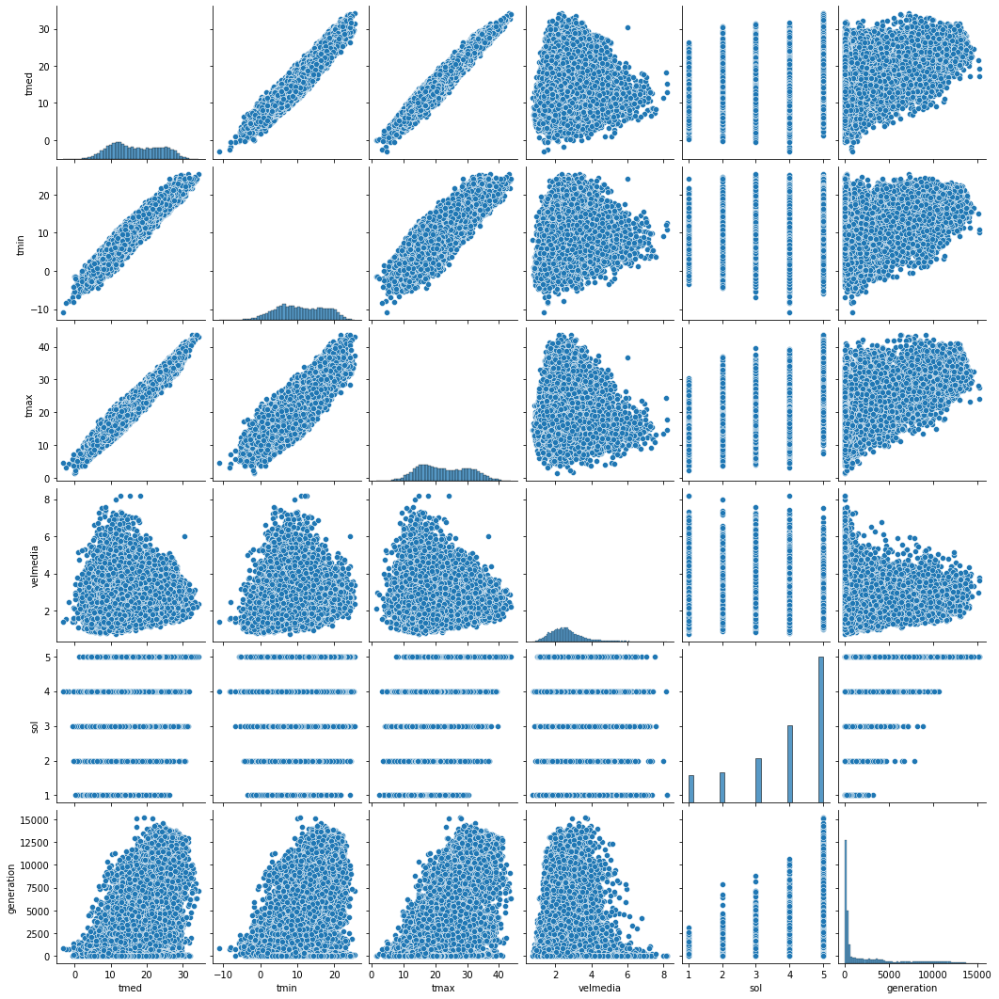

In [ ]:
plot_correlation(df_solartermica)

Velmedia is not really interesting here, it's probably worth it to drop it. For modelling purposes, it will ve also meaningfull just to have one temperature variable, 'tmed' as a reference. Otherwise those variables were going to affect the model as they are highly correlated (multicollinearity) 'Sol', as in the case of 'solar fotovoltaica' has a direct correlation also. Let's confirm this with the correlattion heatmap:

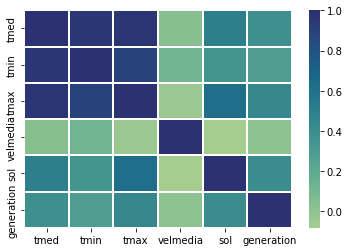

In [ ]:
plot_heatmap(df_solartermica)

It confirms that there are some variables that we can directly eliminate prior to the modelling:

In [ ]:
def transform_df_solartermica(solartermica_df):
    solartermica_df = solartermica_df.drop(columns = ['velmedia', 'tmin', 'tmax'], axis = 1)
    return solartermica_df


In [ ]:
df_solartermica = transform_df_solartermica(df_solartermica)

In [ ]:
df_solartermica.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 17532 entries, 0 to 52594
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   fecha               17532 non-null  datetime64[ns]
 1   comunidad_autonoma  17532 non-null  object        
 2   tmed                17532 non-null  float64       
 3   sol                 17488 non-null  float64       
 4   generation          17532 non-null  float64       
dtypes: datetime64[ns](1), float64(3), object(1)
memory usage: 821.8+ KB


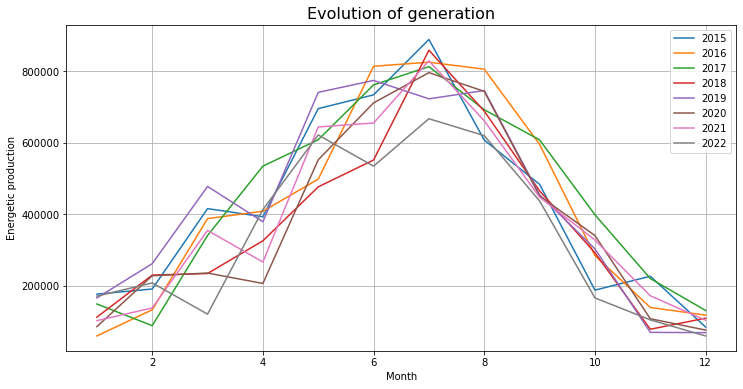

In [ ]:
#Let's see the evolution over the years and over a year:
plot_generation_evolution(df_solartermica)

It seems that the generation with 'solartermica' technology was speiclly low in the last year and that it's highly related to the heatest months of the year.

Let's plot now the other plots with geographical - or administrative -  information. The aim is to study or to easily see which CCAA are the ones that are generating more 'Solartermica' energy. \
Let's check how the productionby CCAA was last year:

No handles with labels found to put in legend.


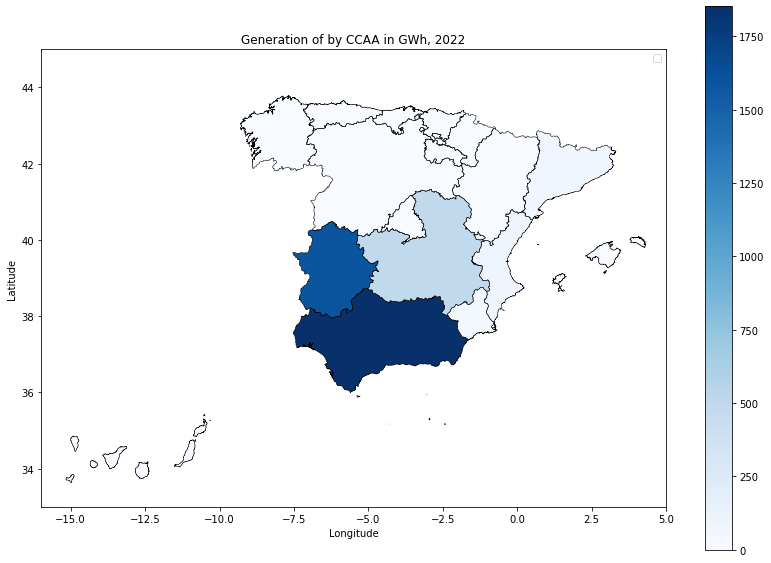

In [ ]:
plot_map_generation(spain, df_solartermica, 2022)

Time now to see the geographical information for the other variabes of teh dataframe to see the correlation also geographically:

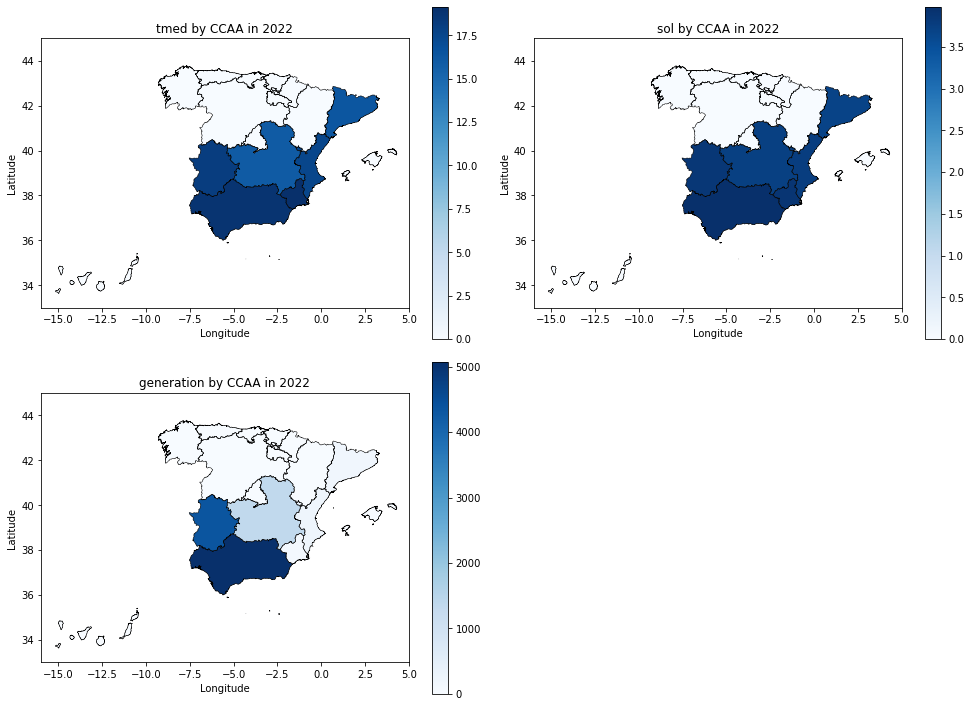

In [ ]:
plot_map_generation_withvariables(spain, df_solartermica, 2022)

'sol' and 'tmed' seem to be highly related witg 'generation. Probably because a lack of investment in other CCAAs the production is not that high as in Extremadura or Andalucia, as we see that there are also oher CCAAs that seem to be a good opportunity for 'solar termica' production.

#### 1.6.3 Eólica

For Eolic genetation we are considering variables related to the wind, but we are incling also variables related to prec, or temperature. These other variables can have muticolinearity, but there can be also responsible for eolic generation, as wind levels depend also of the changes in the temperature between areas, as it is explainded in the following article:https://www.windlogger.com/blogs/news/how-does-cold-weather-affect-wind-speed,  'Winds tend to be stronger during winter, and this can be explained with the uneven heating of the Earth’s surface'. Let's see if we can confirm this hypothesis analyzing the data we have extracted from AEMET.  \
First of all, let's check again the correlation between the variables inluded:

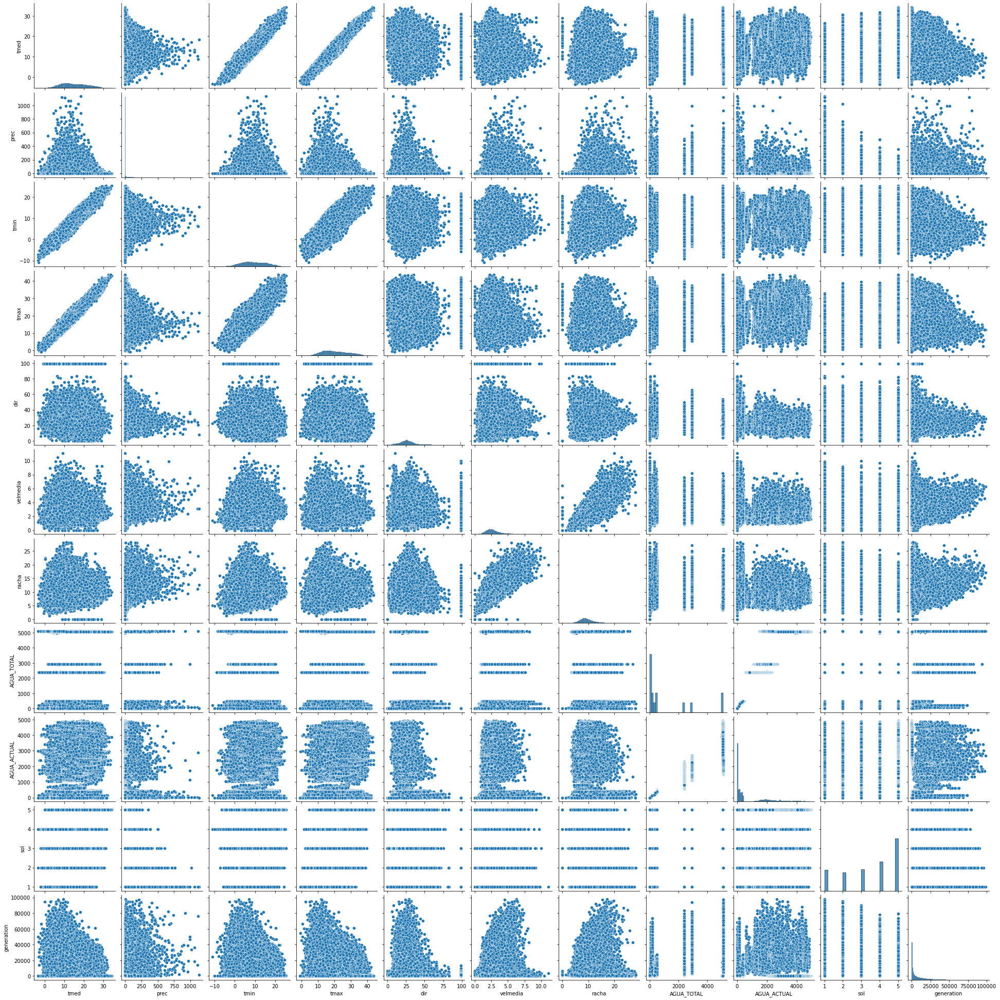

In [ ]:
plot_correlation(df_eolica)

Several of the variables seem to not be really related to the generation of eolic (AGUA_TOTAL, AGUA_ACTUAL, sol and others that apparently have multicolineality: dir, tmax, tmin), therefore we are removing them from the dataframe:

In [ ]:
def transform_df_eolica(eolica_df):
    eolica_df = eolica_df.drop(columns = ['tmax', 'tmin','sol', 'AGUA_TOTAL', 'AGUA_ACTUAL', 'dir', 'prec'], axis = 1)
    return eolica_df


In [ ]:
df_eolica = transform_df_eolica(df_eolica)

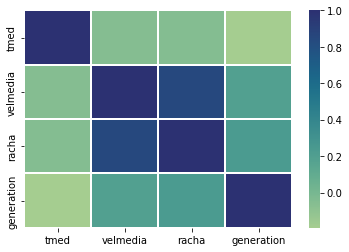

In [ ]:
#Let's see now the heatmap:
plot_heatmap(df_eolica)

It seems that most of the variables are highy related in the remain dataframe. Let's see the evolution over the years and over a single year:

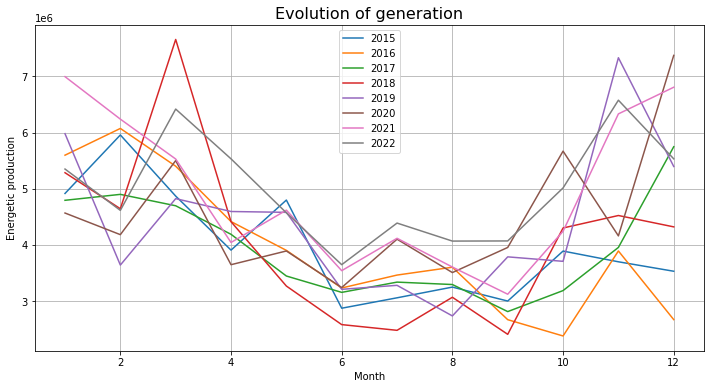

In [ ]:
plot_generation_evolution(df_eolica)

Generation is increasing over the last years due to a higher investment in this technology which is increasing it's capacity (4,9% in comparison with 2021, information provided by Re: https://www.sistemaelectrico-ree.es/informe-de-energias-renovables/viento/potencia-instalada-viento#:~:text=La%20e%C3%B3lica%20representa%20la%20principal,en%20todo%20el%20territorio%20espa%C3%B1ol.) \
Over a year it seems tohave the opposite relation to the 'solar ones': it is specially high during winter.
Let's see the produciton now with the geographical info in the last year:


No handles with labels found to put in legend.


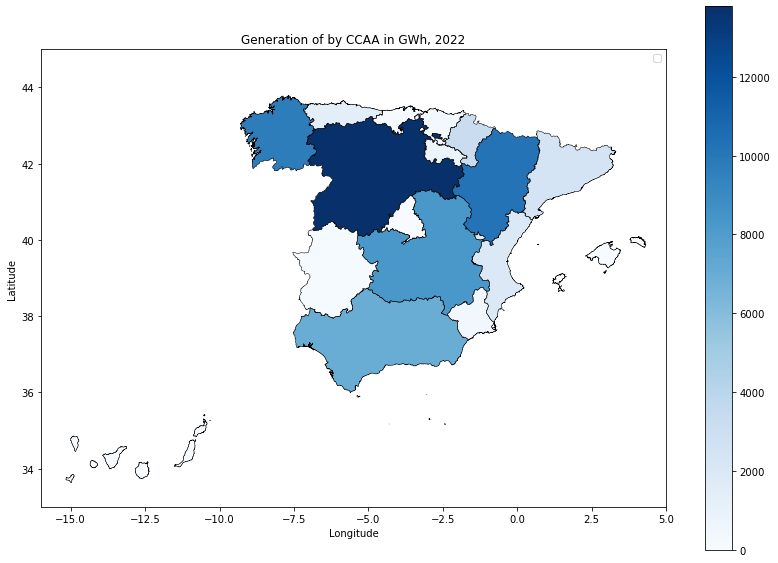

In [ ]:
plot_map_generation(spain,df_eolica,2022)

The provinces with the highest levels of production in 2022 were Galicia, Aragon and specially Castilla y León. Let's see now if it is related also geographically with the other variables:


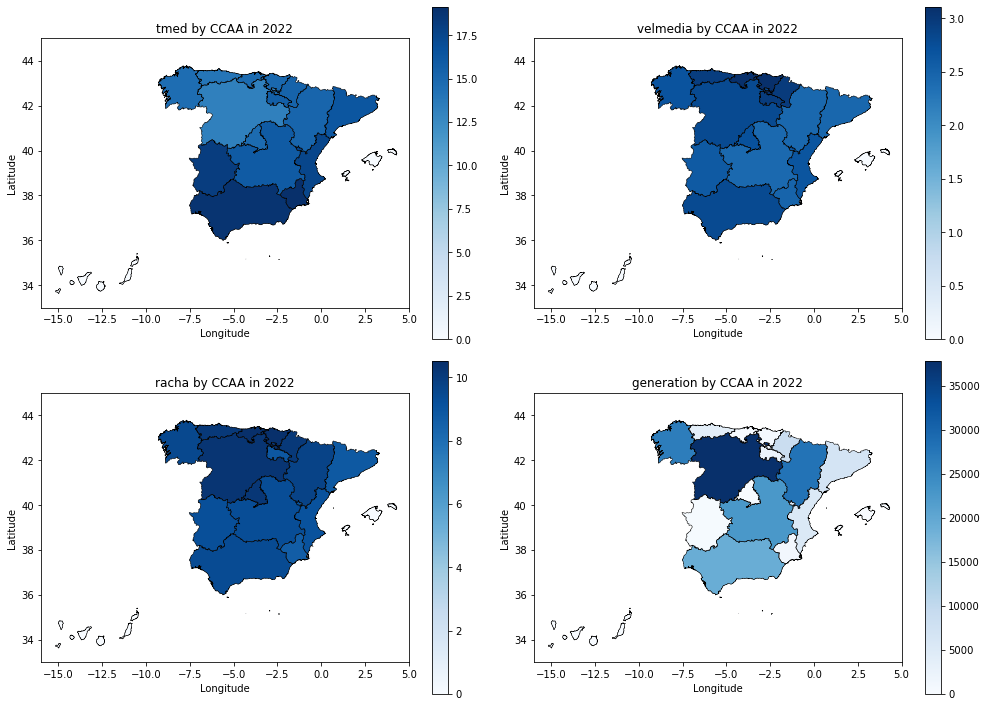

In [ ]:
plot_map_generation_withvariables(spain, df_eolica, 2022)

It seens that specially 'racha', which isthe highest speed of the day, could be really related to 'generation'. However, when doing the mean in trhe gorupbys we have probably lost some accuracy.

#### 1.6.4 Hidráulica

For hidraulica, we are including several weather variables, but it will always depend on the main variable that resume all the others: the level of water in the damd (AGUA_ACTUAL) as the generation will depend on goverment or energetic-companies decissions based on the 'hudraulic-stress' of an area or territory.

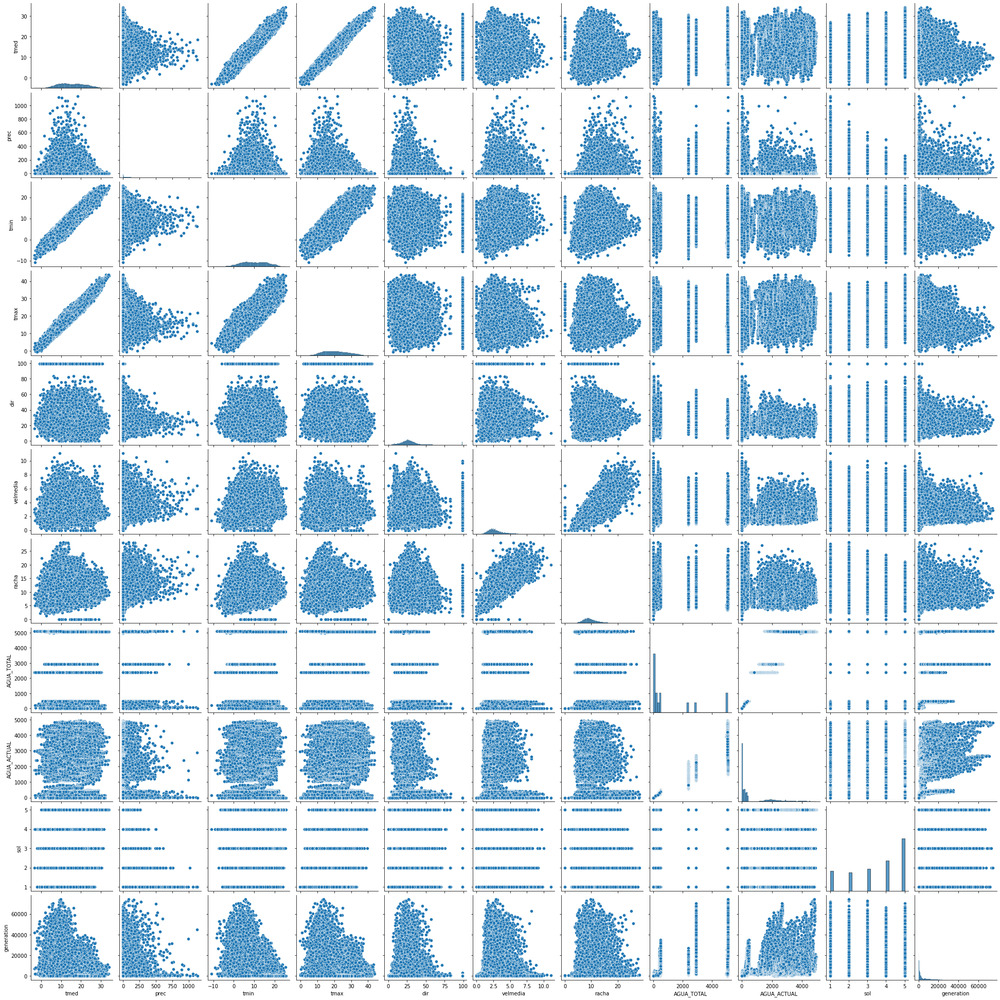

In [ ]:
plot_correlation(df_hidraulica)

In [ ]:
#There are some variables we can drop already:
def transform_df_hidraulica(hidraulica_df):
    hidraulica_df = hidraulica_df.drop(columns = ['tmax', 'tmin','sol', 'dir', 'velmedia','racha', 'prec'], axis = 1)
    return hidraulica_df


In [ ]:
df_hidraulica = transform_df_hidraulica(df_hidraulica)

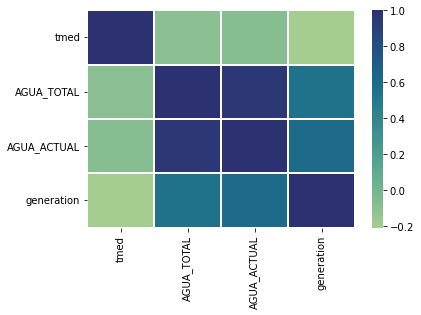

In [ ]:
plot_heatmap(df_hidraulica)

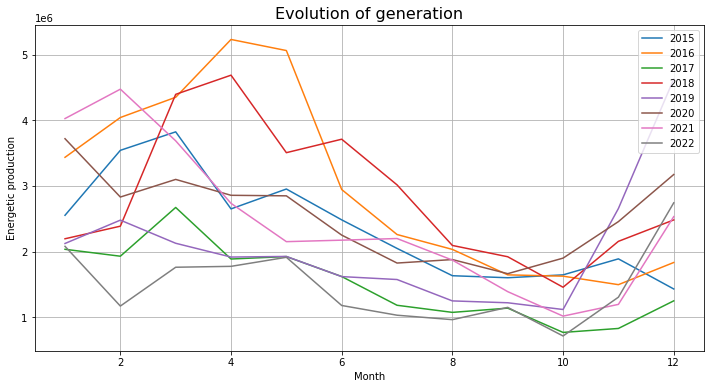

In [ ]:
#LET'S take a look at the generation over the years and on a single year:
plot_generation_evolution(df_hidraulica)

It is interesting to see how the generation start to increase in november when the rainy season has already started. Year 2022 has been a bad year for hidrualic generation, one of the lowest of the last years, as expected due to the lack of rain during the year.

It is true that hidraulic generation does not understand 'administrative' limits as the production and the dams, all the documentation related provided by the ministeries etc. Is split by the river basin and not in CCAAs. However, based on the location of the dams we have been able to alocate and relate all of them to a CCAA, so we can see the information in the same way we have for the other technologies:

No handles with labels found to put in legend.


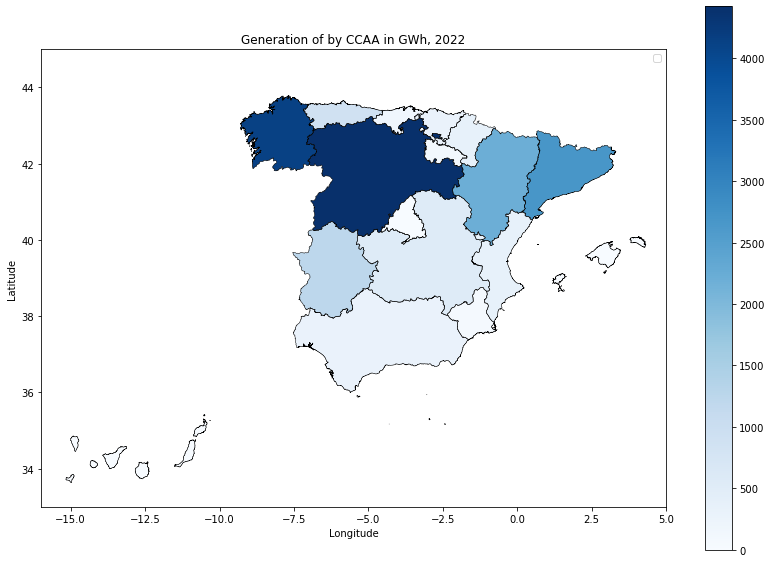

In [ ]:
plot_map_generation(spain,df_hidraulica, 2022)

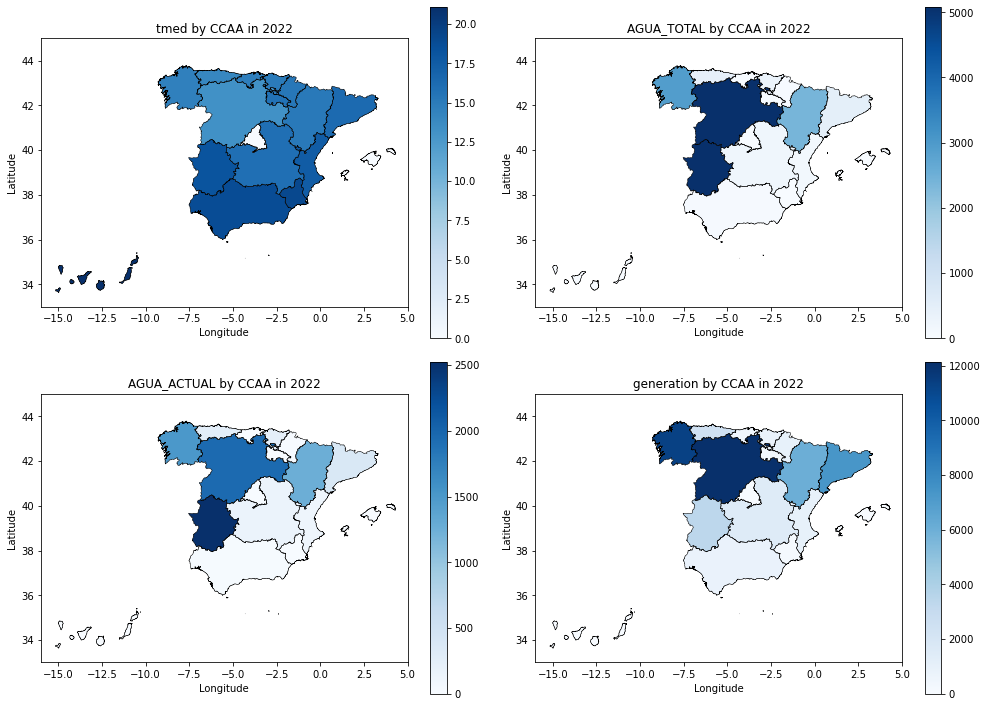

In [ ]:
plot_map_generation_withvariables(spain, df_hidraulica,2022)

This map is not only interesting because it gives us the view of the relation between variables (negative correlation with 'tmed') but also because it shows clearly the situation of hidrological resources in some autonomies like Cataluña.

#### 1.6.5 Demand

The ultimate goal of this project would be to understand the relation between demand and renewable energy genereation in order to see what % of demand can be fullfiled with the estimated generation based on weather forecast. This would help to have a better understaing and prediction of our energetic model and could help to save money to the 'common citizens' as renewable energy is cheaper in principle. \
Taking all this into consideration, it is makes specially relevant to understand how demand works and to see if it is something that can be predicted also based on weather forecast variables and depending on if it's a weekday or not. For sure there are some economical or sociopolitical variables that won't be part of the model and may affect to the demand, but the aim here is to really analyze if the model can work properly exclusively based on weather forecasting. Let's see if we can get some conclusions just visualizing the data of the 'demand dataframe':

In [ ]:
#We already have the dataframe filtered:
df_demand.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 52595 entries, 0 to 52594
Data columns (total 14 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   fecha               52595 non-null  datetime64[ns]
 1   comunidad_autonoma  52595 non-null  object        
 2   tmed                52595 non-null  float64       
 3   prec                52595 non-null  float64       
 4   tmin                52595 non-null  float64       
 5   tmax                52595 non-null  float64       
 6   dir                 52595 non-null  float64       
 7   velmedia            52595 non-null  float64       
 8   racha               52595 non-null  float64       
 9   AGUA_TOTAL          52595 non-null  float64       
 10  AGUA_ACTUAL         52595 non-null  float64       
 11  sol                 51351 non-null  float64       
 12  demand_ccaa         52595 non-null  float64       
 13  Weekday             52595 non-null  int64     

In [ ]:
#This is how it looks like:
df_demand.head()

,fecha,comunidad_autonoma,tmed,prec,tmin,tmax,dir,velmedia,racha,AGUA_TOTAL,AGUA_ACTUAL,sol,demand_ccaa,Weekday
0,2015-01-01,ANDALUCIA,8.434,0.000,1.429,15.422,22.818,2.400,8.297,80.440,51.390,4.000,88259.789,1
1,2015-01-01,ARAGON,5.167,0.000,-2.033,12.383,29.417,1.818,8.428,2434.490,2006.580,4.000,22882.569,1
2,2015-01-01,CANARIAS,17.250,0.000,15.012,19.519,44.292,4.779,12.431,0.000,0.000,2.000,18441.931,1
3,2015-01-01,CANTABRIA,7.357,0.000,1.100,13.657,35.500,1.867,5.083,108.100,73.410,4.000,9493.101,1
4,2015-01-01,CASTILLA Y LEON,4.191,0.000,-3.507,11.926,26.646,1.653,5.680,5001.480,4029.590,4.000,32044.289,1


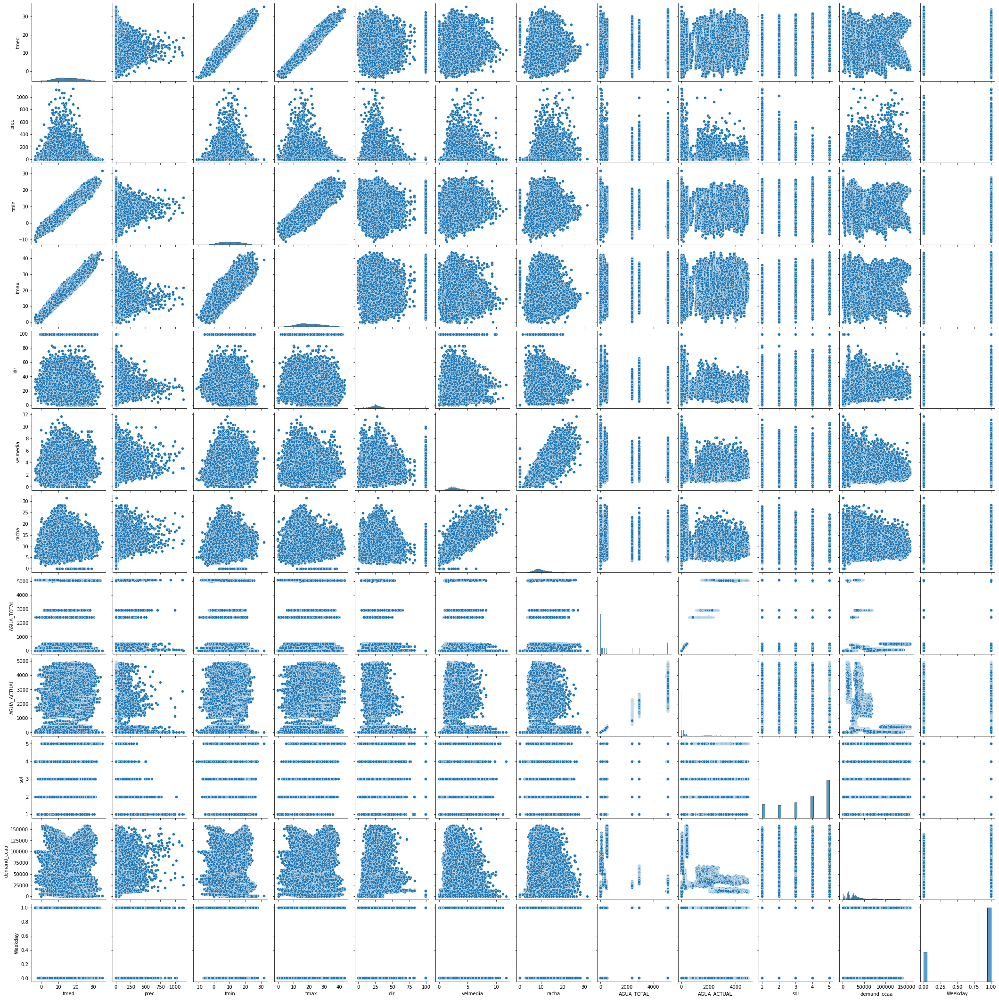

In [ ]:
plot_correlation(df_demand)

As we can see, most of the variables seem uninteresting, we are including 'weekday', 'tmed' (interesting to see how when the temperature it's abour 15% the demand decreases), and 'velmedia' as seems to have also some impact in the final output.

In [ ]:
def transform_df_demand(demand_file):
    demand_file = demand_file[['fecha','tmed','velmedia', 'Weekday','demand_ccaa','comunidad_autonoma']]
    return demand_file

In [ ]:
df_demand = transform_df_demand(df_demand)

In [ ]:
df_demand.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 52595 entries, 0 to 52594
Data columns (total 6 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   fecha               52595 non-null  datetime64[ns]
 1   tmed                52595 non-null  float64       
 2   velmedia            52595 non-null  float64       
 3   Weekday             52595 non-null  int64         
 4   demand_ccaa         52595 non-null  float64       
 5   comunidad_autonoma  52595 non-null  object        
dtypes: datetime64[ns](1), float64(3), int64(1), object(1)
memory usage: 4.8+ MB


Let's see now the heatmap and the other plots. The name of the functions is 'generation' but we are talking about the demand.

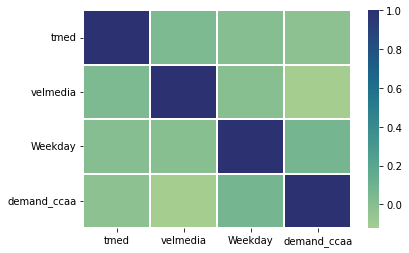

In [ ]:
plot_heatmap(df_demand)

In [ ]:
plot_generation_evolution(df_demand)

KeyError: 'Column not found: generation'

<Figure size 864x432 with 0 Axes>

In [ ]:
plot_map_generation(spain, df_demand,2022)

KeyError: 'fecha'

In [ ]:
plot_map_generation_withvariables(spain, df_demand, 2022)

AÑADIR CONCLUSIONES DE DEMAND Y EMPEZAR CON MODELO. ONEHOTENCODER?? STANDARIZACION DE VARIABLES?